# Conditional GAN

In this notebook, we're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

We'll then do some exploration of the generated images to visualize what the noise and class vectors mean.

 The generator will no longer take z_dim as an argument, but input_dim instead, since we need to pass in both the noise and class vectors.

In [27]:
import os
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
#from torchvision.transforms import ToTensor, Normalize, Compose, Resize
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchvision.utils import save_image
from IPython.display import Image
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()


In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

In [3]:
def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

# Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. 

The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class.

The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. 

There is a class within the PyTorch functional library that can help.

In [5]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
   
    return F.one_hot(labels, num_classes= n_classes)
   

# PyTorch One Hot Encoding

PyTorch has a one_hot() function for converting class indices to one-hot encoded targets:

If you don’t pass the num_classes argument in, one_hot() will infer the number of classes to be the largest class index plus one.

In [ ]:
import torch
import torch.nn.functional as F

x = torch.tensor([4, 3, 2, 1, 0])
F.one_hot(x, num_classes=6)

In [ ]:
x = torch.tensor([4, 3, 2, 1, 0])
F.one_hot(x)

If you have more than one dimension in your class index tensor, one_hot() will encode labels along the last axis:

In [ ]:
x = torch.tensor([
    [1, 2],
    [3, 6],
])
F.one_hot(x)

If you want to reverse the operation, transforming a tensor from one-hot encoding to class indices, use the .argmax() method over the last index:

In [ ]:
x = torch.tensor([4, 3, 2, 1, 0])
y = F.one_hot(x, num_classes=6)
y.argmax(-1)

# Combine Vectors

Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats

In [6]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    
    combined = None
    combined = torch.cat((x.float(),y.float()),1)
    return combined

# Training

Now you can start to put it all together! First, you will define some new parameters:

mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [7]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

criterion: the loss function

n_epochs: the number of times you iterate through the entire dataset when training

z_dim: the dimension of the noise vector

display_step: how often to display/visualize the images

batch_size: the number of images per forward/backward pass

lr: the learning rate

device: the device type

In [12]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 500
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'


transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers.

To do this, you will need to update the input dimensions for both models.

For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [14]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
   
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    
    return generator_input_dim, discriminator_im_chan

In [15]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)


In [16]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:

Tell that to the generator, so that it knows it should be generating a "1"
Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

In [ ]:
one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
one_hot_labels

In [ ]:
for real, labels in (dataloader):
    pass
cur_batch_size = len(real)
# Flatten the batch of real images from the dataset
real = real.to(device)

#labels.fill_(6)
one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
image_one_hot_labels = one_hot_labels[:, :, None, None]
image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

### Update discriminator ###
# Zero out the discriminator gradients
disc_opt.zero_grad()
# Get noise corresponding to the current batch_size 
fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
# Now you can get the images from the generator
# Steps: 1) Combine the noise vectors and the one-hot labels for the generator
#        2) Generate the conditioned fake images
       
#### START CODE HERE ####
print("***********Printing Labels*****************")
print(labels)
print("***********Printing one_hot_labels*****************")
print(one_hot_labels)
noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
fake = gen(noise_and_labels)
print("***********Printing Fake*****************")
print(fake.shape)
#plt.imshow(fake[0].cpu, cmap='gray')

fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
print("***********Printing fake_image_and_labels*****************")
print(fake_image_and_labels.shape)
torch.flatten(fake_image_and_labels).shape
#plt.imshow(fake_image_and_labels[0], cmap='gray')
#### END CODE HERE ####        
        
    

# Putting it all together

In [ ]:
def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)

In [24]:
sample_dir = 'WithGrid-MNIST-CGAN-6Dec'
if not os.path.exists(sample_dir):
    os.makedirs(sample_dir)

In [25]:
sample_dir_1 = 'withOutGrid-MNIST-CGAN-6Dec'
if not os.path.exists(sample_dir_1):
    os.makedirs(sample_dir_1)

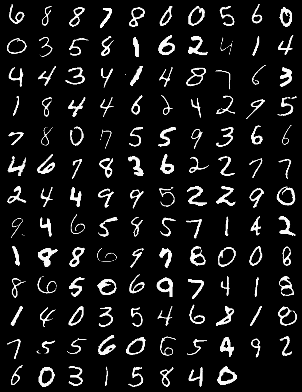

In [28]:
# Save some real images in grid and without grid
for images, _ in dataloader:
    #print(images)
    #print(torch.numel(images)) # 100 * 1 * 28 * 28
    images = images.reshape(images.size(0), 1, 28, 28)
    save_image(denorm(images), os.path.join(sample_dir, 'real_images.png'), nrow=10)
    for i in range(images.size(0)):
        save_image(denorm(images[i]), os.path.join(sample_dir_1, 'real_images'+str(i)+'.png'), nrow=10)
    break
   
Image(os.path.join(sample_dir, 'real_images.png'))

Saving fake_images-0000.png


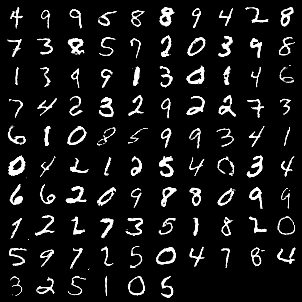

In [34]:
def save_fake_images(index,fake):
    #fake_images = gen(fake_noise)
    fake_images = fake.reshape(fake.size(0), 1, 28, 28)
    fake_fname = 'fake_images-{0:0=4d}.png'.format(index)
    print('Saving', fake_fname)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=10)
    for i in range(fake_images.size(0)):
        save_image(denorm(fake_images[i]), os.path.join(sample_dir_1, 'Epoch-'+str(index)+'-fake_images'+str(i)+'.png'), nrow=10)

    
# Before training
save_fake_images(0,fake)
Image(os.path.join(sample_dir, 'fake_images-0000.png'))

# Full Training Loop

In [ ]:
epoch_flag = False

  0%|          | 0/469 [00:00<?, ?it/s]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!
Saving fake_images-0916.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 1, step 500: Generator loss: 1.1499115005731582, discriminator loss: 0.5609838604331017


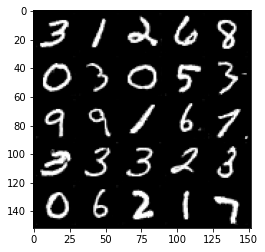

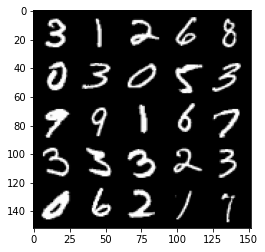

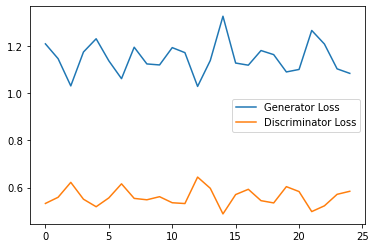

Saving fake_images-0917.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2, step 1000: Generator loss: 1.1556242126226426, discriminator loss: 0.551940667629242


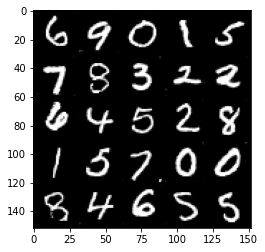

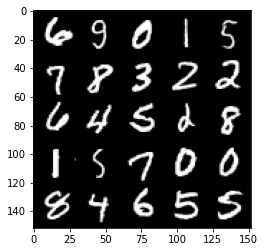

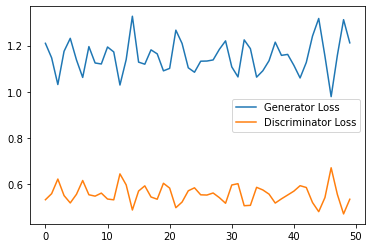

Saving fake_images-0918.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3, step 1500: Generator loss: 1.1450667855739594, discriminator loss: 0.5604964604973793


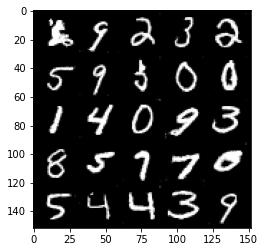

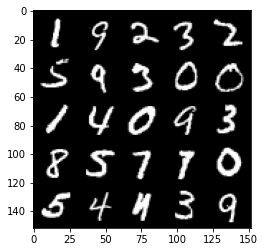

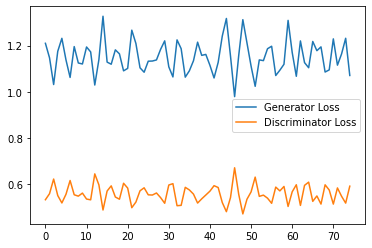

Saving fake_images-0919.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4, step 2000: Generator loss: 1.1586753273010253, discriminator loss: 0.5584444370269775


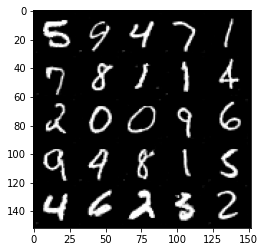

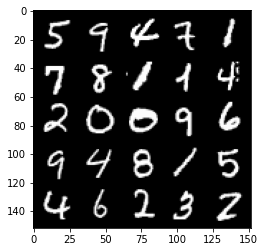

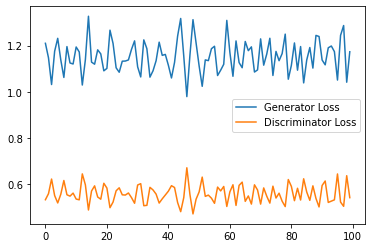

Saving fake_images-0920.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5, step 2500: Generator loss: 1.1464370783567428, discriminator loss: 0.5568897858262062


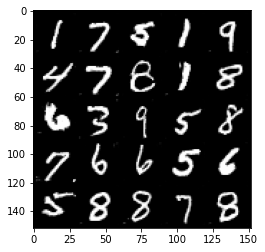

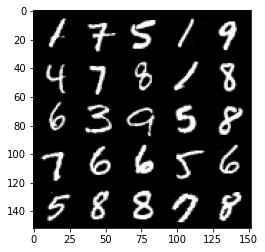

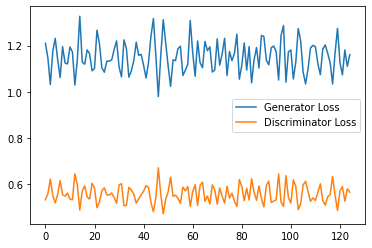

Saving fake_images-0921.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6, step 3000: Generator loss: 1.1587220160961151, discriminator loss: 0.5560540307760239


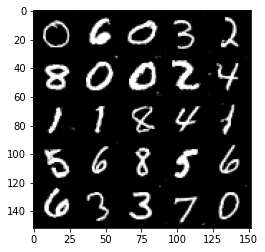

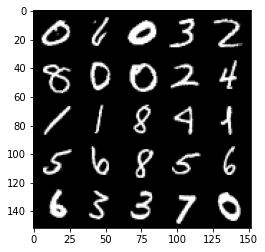

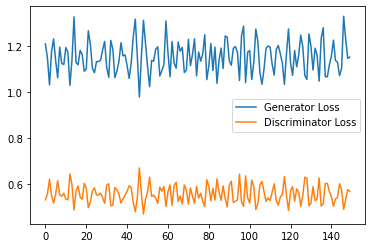

Saving fake_images-0922.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7, step 3500: Generator loss: 1.1609563789367676, discriminator loss: 0.5582312533855438


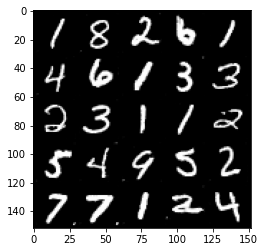

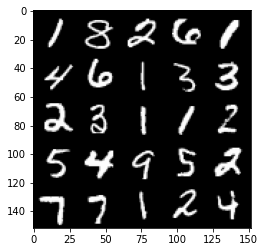

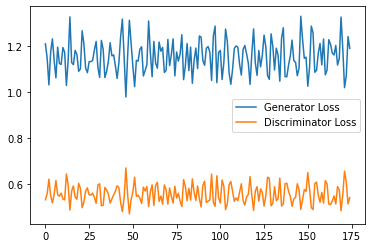

Saving fake_images-0923.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8, step 4000: Generator loss: 1.1733105883598327, discriminator loss: 0.5515782045722007


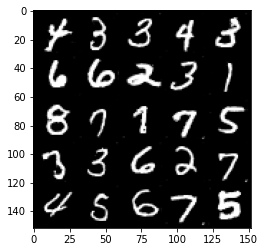

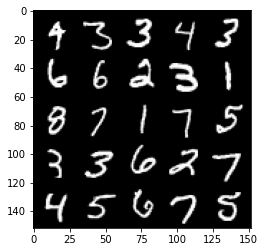

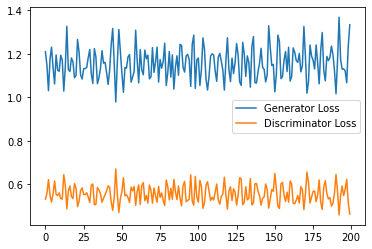

Saving fake_images-0924.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9, step 4500: Generator loss: 1.1540080082416535, discriminator loss: 0.5609829345345497


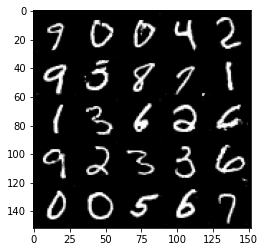

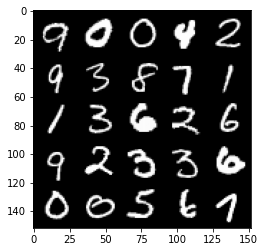

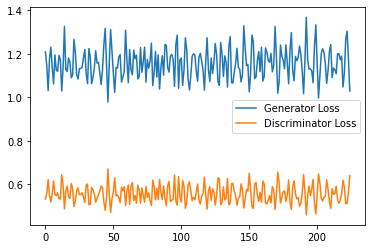

Saving fake_images-0925.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10, step 5000: Generator loss: 1.1606040871143342, discriminator loss: 0.5615211013555527


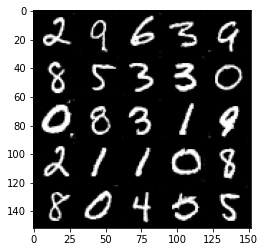

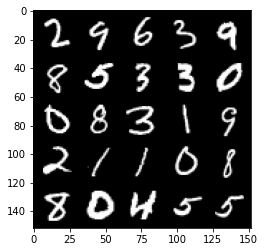

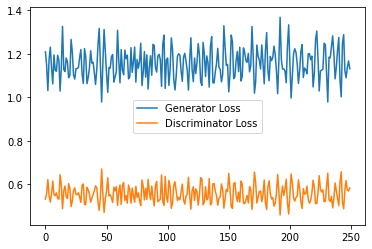

Saving fake_images-0926.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11, step 5500: Generator loss: 1.1589564578533174, discriminator loss: 0.5549575382471085


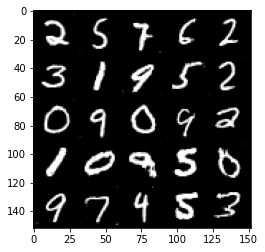

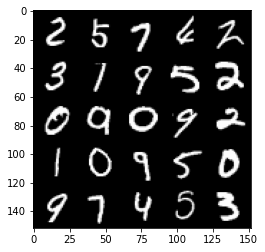

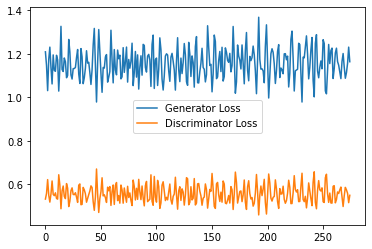

Saving fake_images-0927.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12, step 6000: Generator loss: 1.156798238158226, discriminator loss: 0.5543277976512909


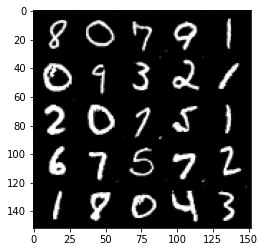

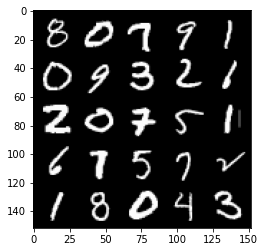

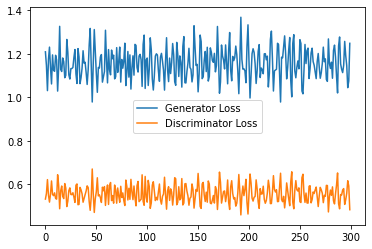

Saving fake_images-0928.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13, step 6500: Generator loss: 1.1657319284677505, discriminator loss: 0.5562049254775048


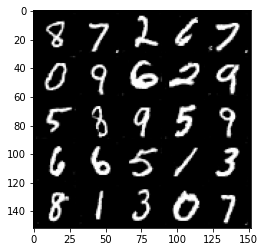

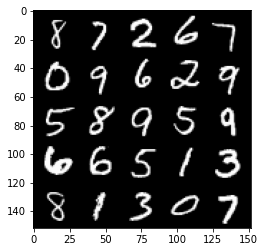

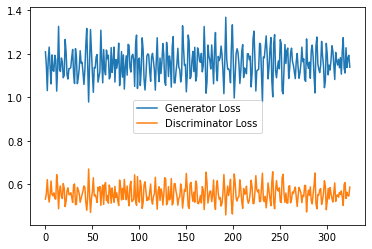

Saving fake_images-0929.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14, step 7000: Generator loss: 1.1696549075841904, discriminator loss: 0.5540009838938713


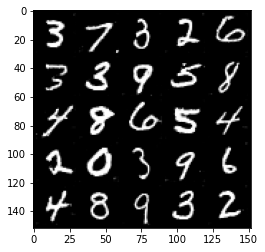

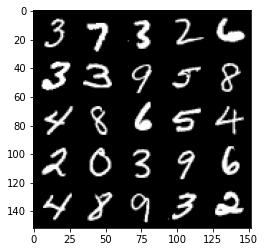

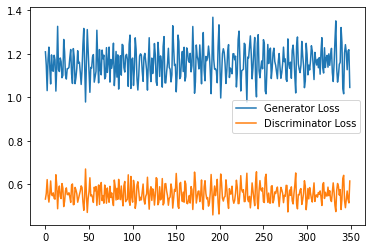

Saving fake_images-0930.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15, step 7500: Generator loss: 1.1692841744422913, discriminator loss: 0.5578366612792015


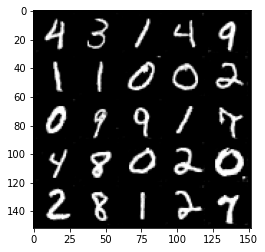

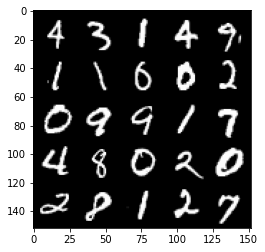

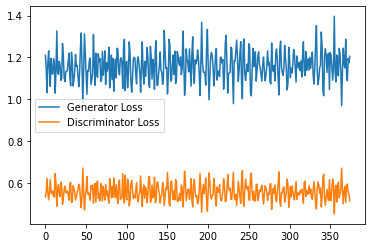

Saving fake_images-0931.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-0932.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 17, step 8000: Generator loss: 1.1590577322244644, discriminator loss: 0.5632781838178634


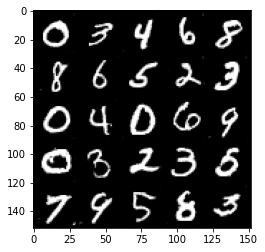

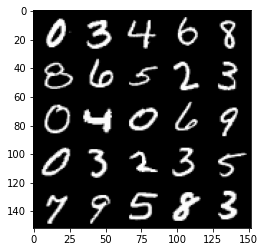

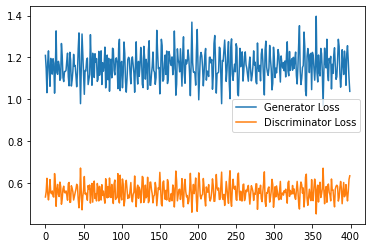

Saving fake_images-0933.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18, step 8500: Generator loss: 1.1625647950172424, discriminator loss: 0.5507490350008011


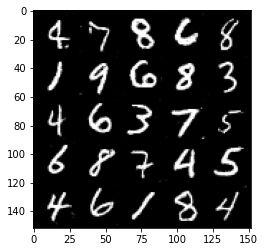

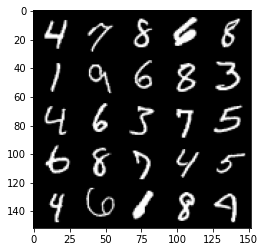

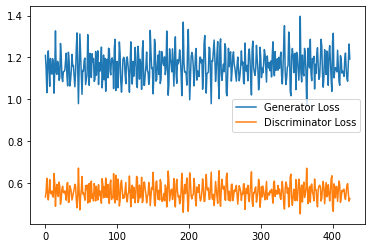

Saving fake_images-0934.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19, step 9000: Generator loss: 1.153742176413536, discriminator loss: 0.5600349412560462


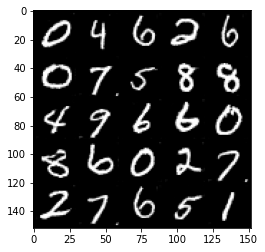

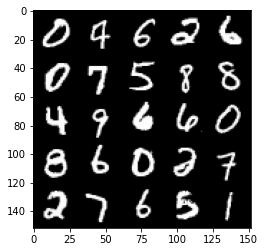

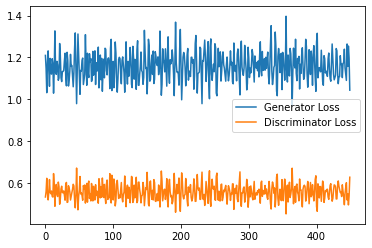

Saving fake_images-0935.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20, step 9500: Generator loss: 1.1642158652544021, discriminator loss: 0.5540169095396995


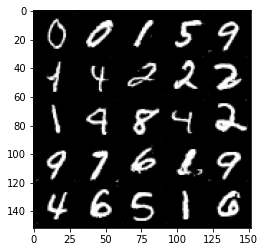

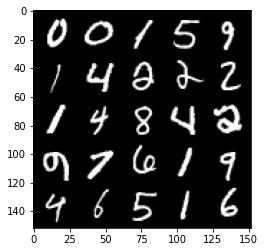

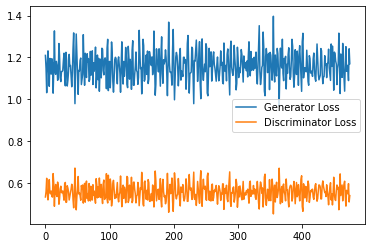

Saving fake_images-0936.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21, step 10000: Generator loss: 1.1597656580209732, discriminator loss: 0.5568349960446358


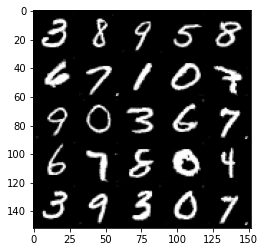

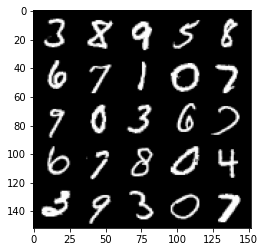

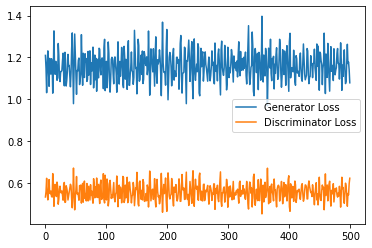

Saving fake_images-0937.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22, step 10500: Generator loss: 1.178889519572258, discriminator loss: 0.546517075240612


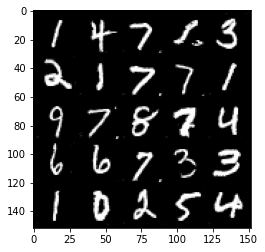

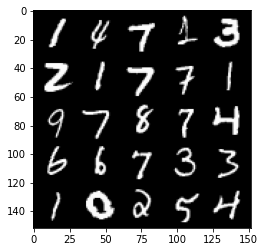

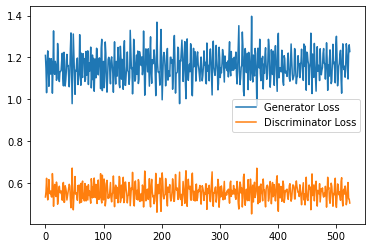

Saving fake_images-0938.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23, step 11000: Generator loss: 1.1647125035524368, discriminator loss: 0.5597099546790123


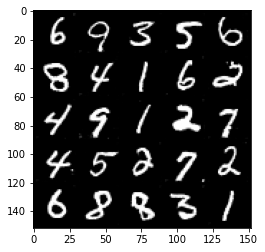

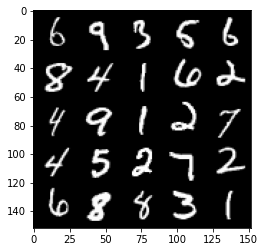

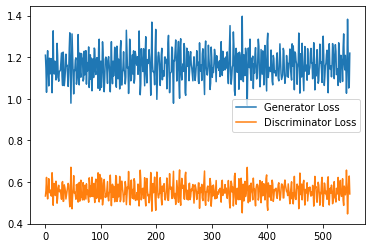

Saving fake_images-0939.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24, step 11500: Generator loss: 1.167349106192589, discriminator loss: 0.5543566479086875


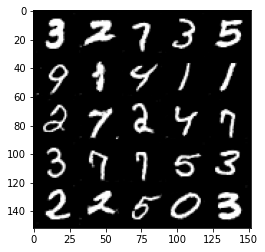

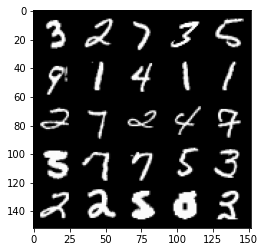

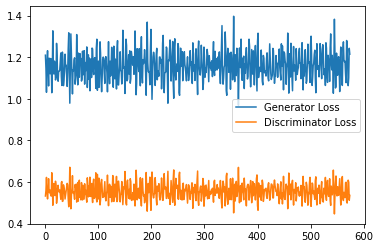

Saving fake_images-0940.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25, step 12000: Generator loss: 1.1604565070867539, discriminator loss: 0.5550344455242157


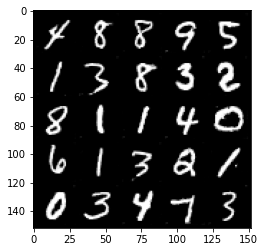

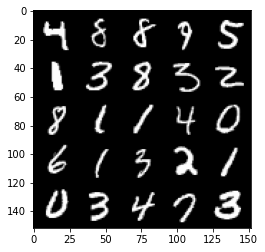

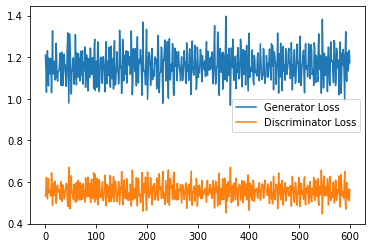

Saving fake_images-0941.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26, step 12500: Generator loss: 1.1679274113178253, discriminator loss: 0.5547074267864227


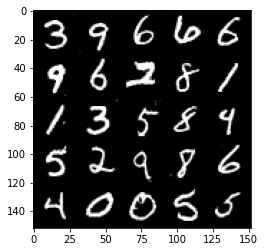

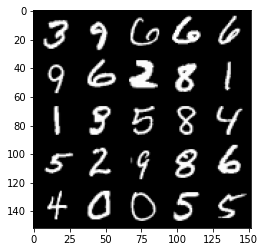

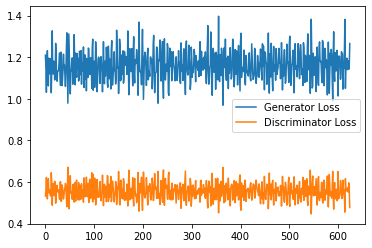

Saving fake_images-0942.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27, step 13000: Generator loss: 1.1536974523067474, discriminator loss: 0.558061127960682


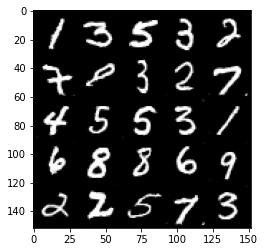

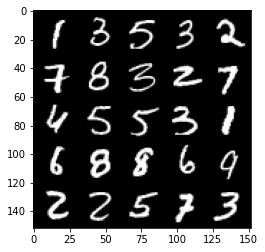

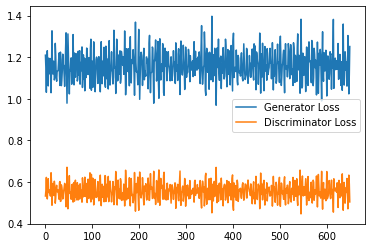

Saving fake_images-0943.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28, step 13500: Generator loss: 1.1627410949468613, discriminator loss: 0.5605656927227974


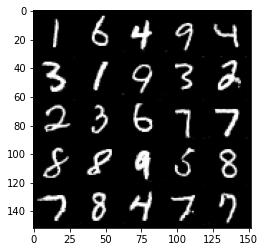

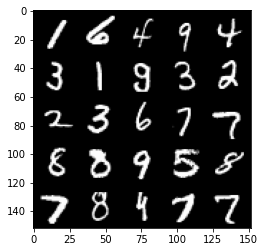

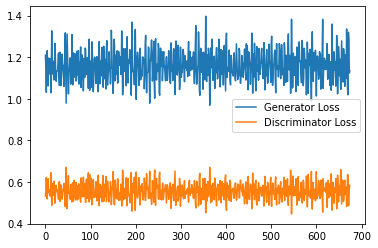

Saving fake_images-0944.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29, step 14000: Generator loss: 1.1628207473754884, discriminator loss: 0.5526702600121498


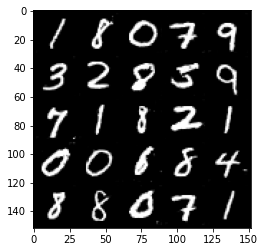

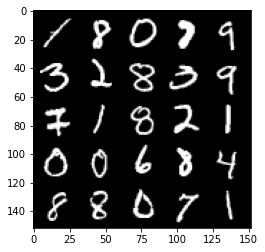

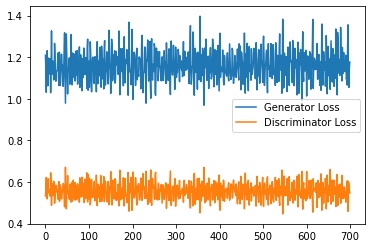

Saving fake_images-0945.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30, step 14500: Generator loss: 1.173850126028061, discriminator loss: 0.5539330352544785


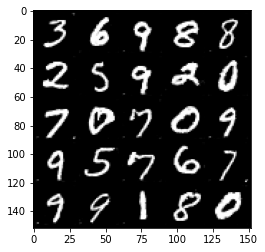

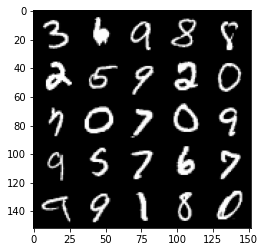

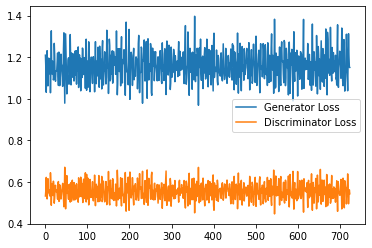

Saving fake_images-0946.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31, step 15000: Generator loss: 1.172178046822548, discriminator loss: 0.5584252796769142


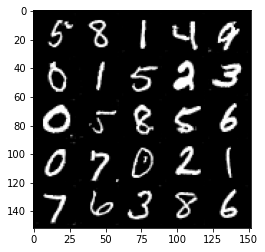

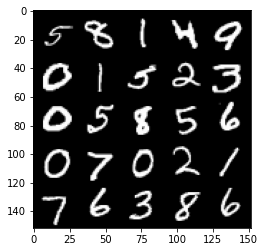

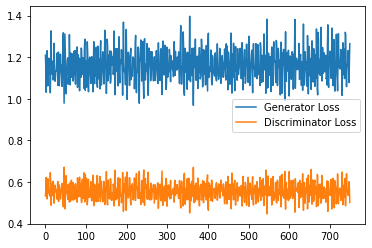

Saving fake_images-0947.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-0948.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 33, step 15500: Generator loss: 1.170069026350975, discriminator loss: 0.5532320577502251


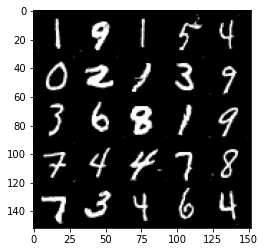

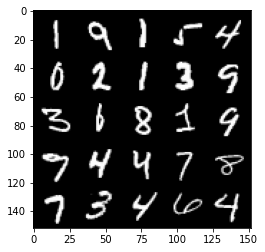

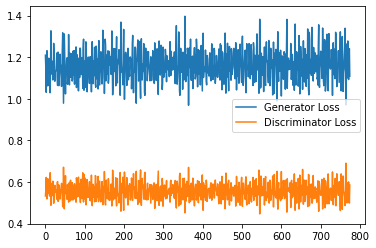

Saving fake_images-0949.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34, step 16000: Generator loss: 1.1602629535198212, discriminator loss: 0.5606018651127815


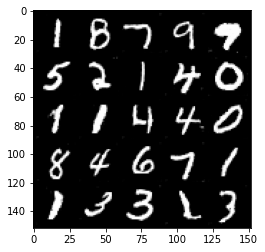

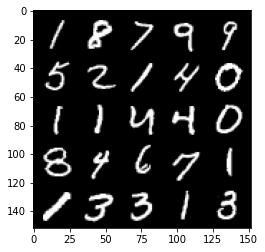

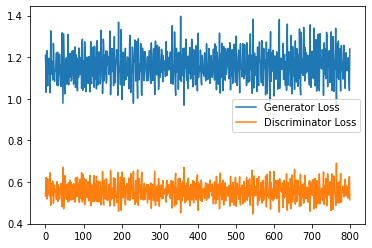

Saving fake_images-0950.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35, step 16500: Generator loss: 1.1733073533773422, discriminator loss: 0.5482364750504494


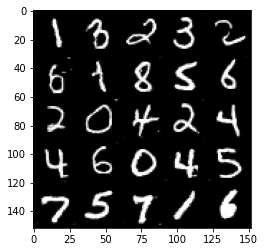

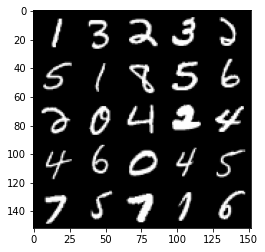

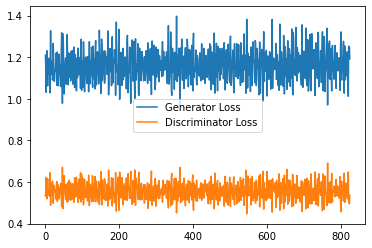

Saving fake_images-0951.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36, step 17000: Generator loss: 1.185381199836731, discriminator loss: 0.5520892588496208


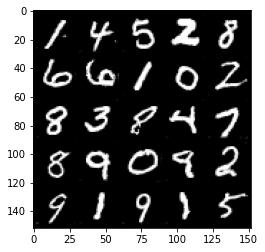

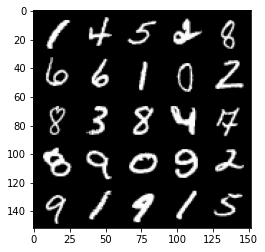

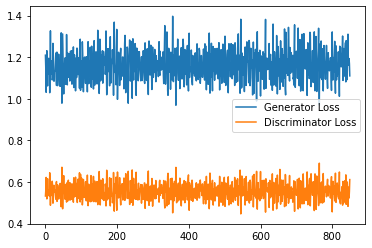

Saving fake_images-0952.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37, step 17500: Generator loss: 1.1695704088211059, discriminator loss: 0.5579118491411209


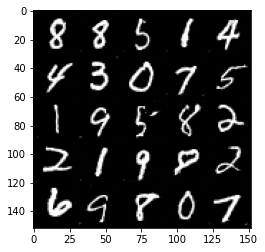

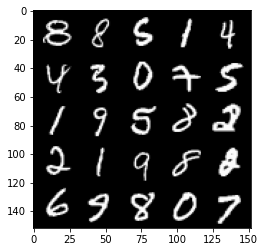

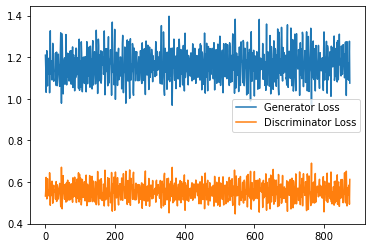

Saving fake_images-0953.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38, step 18000: Generator loss: 1.1550286461114883, discriminator loss: 0.5559610506296158


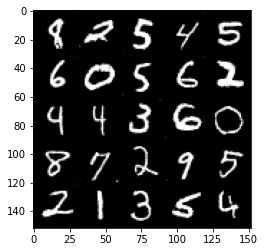

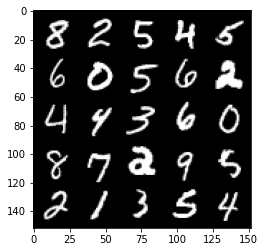

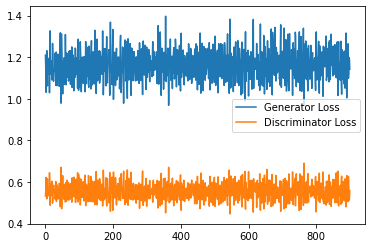

Saving fake_images-0954.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39, step 18500: Generator loss: 1.149204133272171, discriminator loss: 0.5567906101942063


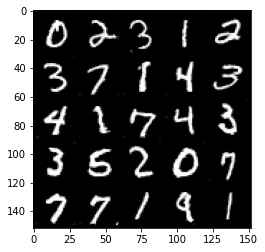

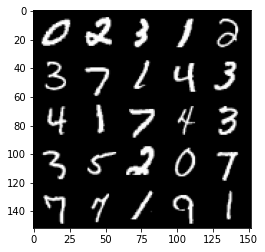

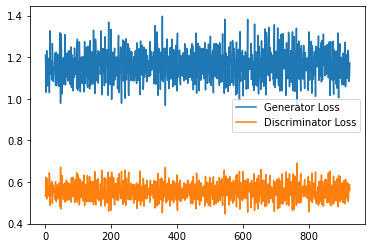

Saving fake_images-0955.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40, step 19000: Generator loss: 1.1668997223377229, discriminator loss: 0.5559388315677642


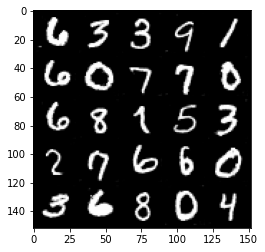

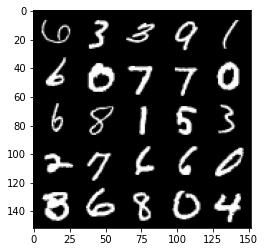

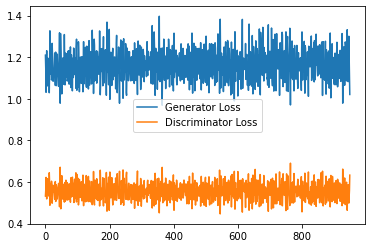

Saving fake_images-0956.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41, step 19500: Generator loss: 1.1774778032302857, discriminator loss: 0.5493337314128875


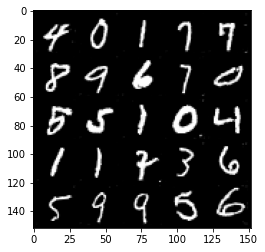

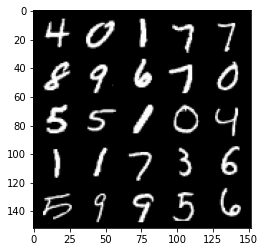

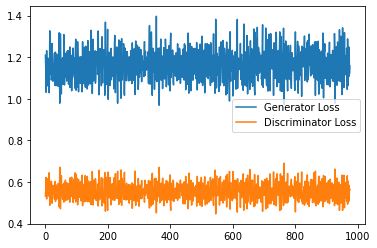

Saving fake_images-0957.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42, step 20000: Generator loss: 1.1801707763671876, discriminator loss: 0.5551560703516006


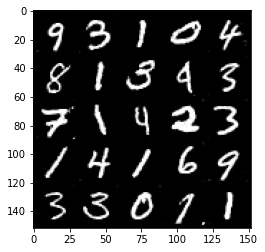

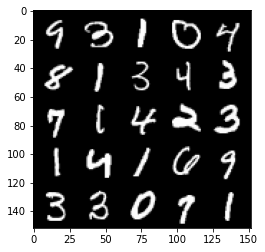

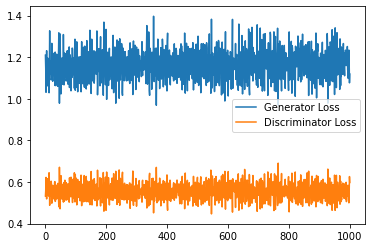

Saving fake_images-0958.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43, step 20500: Generator loss: 1.1715914962291718, discriminator loss: 0.5522944060564041


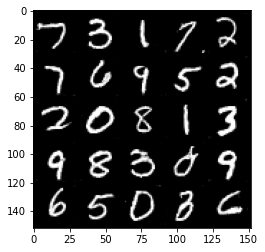

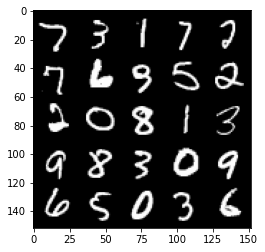

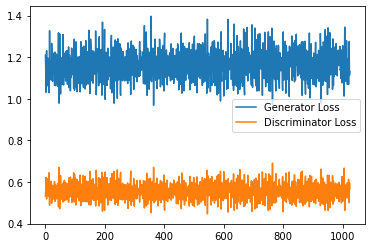

Saving fake_images-0959.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44, step 21000: Generator loss: 1.1894113329648972, discriminator loss: 0.5546715071201325


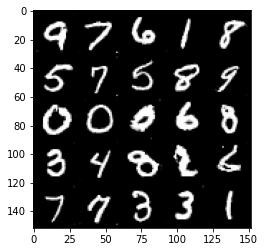

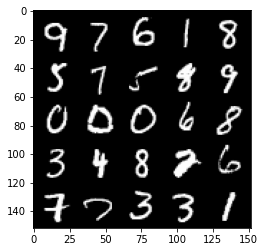

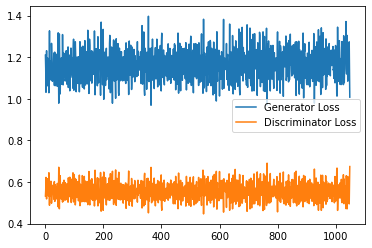

Saving fake_images-0960.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45, step 21500: Generator loss: 1.1767446175813674, discriminator loss: 0.5471555247902871


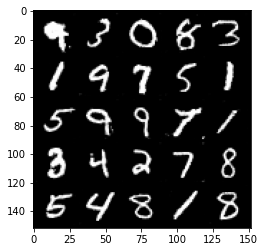

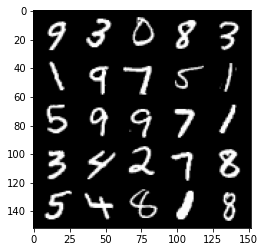

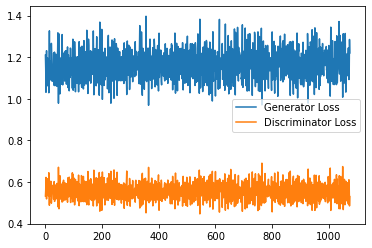

Saving fake_images-0961.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46, step 22000: Generator loss: 1.1657940213680267, discriminator loss: 0.5586158092617989


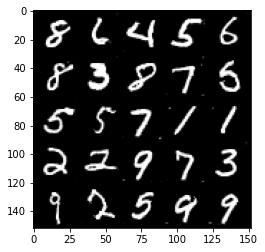

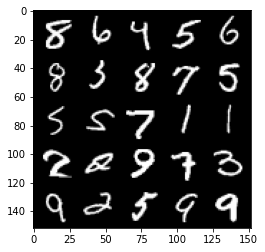

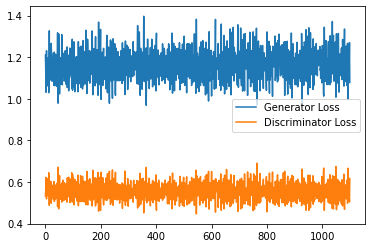

Saving fake_images-0962.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47, step 22500: Generator loss: 1.1669189790487289, discriminator loss: 0.5557713485360145


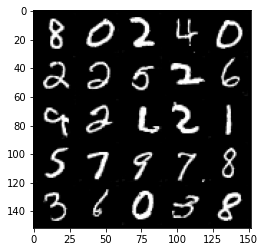

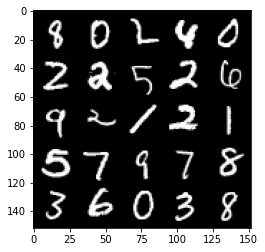

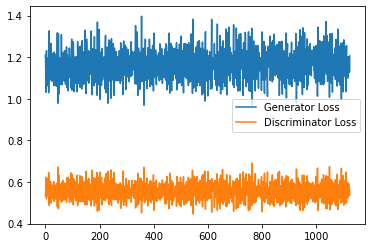

Saving fake_images-0963.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-0964.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 49, step 23000: Generator loss: 1.1724929525852203, discriminator loss: 0.5552234663963318


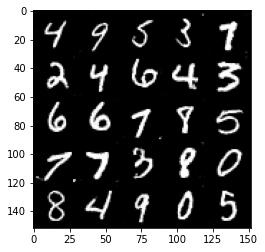

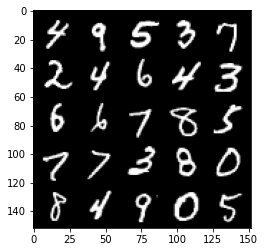

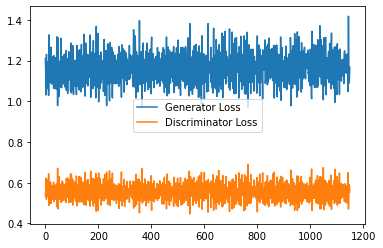

Saving fake_images-0965.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 50, step 23500: Generator loss: 1.197658253312111, discriminator loss: 0.5502888457179069


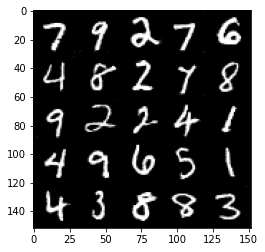

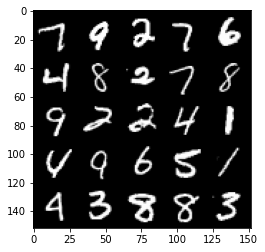

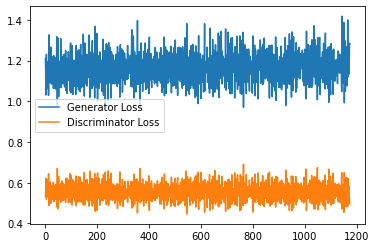

Saving fake_images-0966.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 51, step 24000: Generator loss: 1.1706086823940276, discriminator loss: 0.5587954506278038


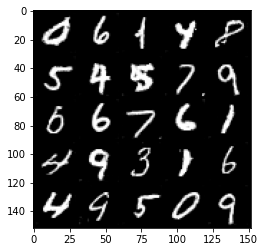

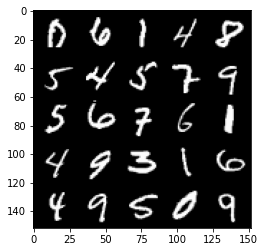

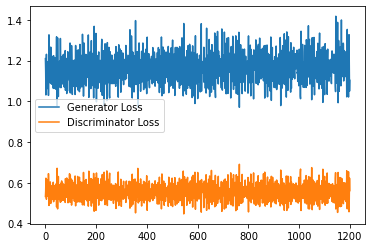

Saving fake_images-0967.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 52, step 24500: Generator loss: 1.1699593323469162, discriminator loss: 0.5473743534684181


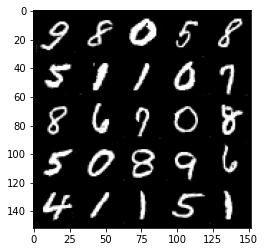

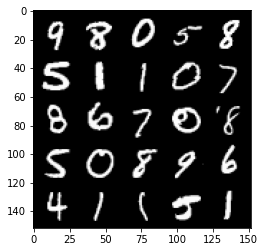

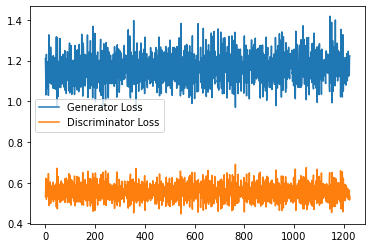

Saving fake_images-0968.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 53, step 25000: Generator loss: 1.1673101732730866, discriminator loss: 0.5557444307208061


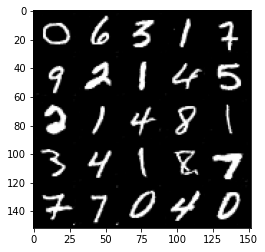

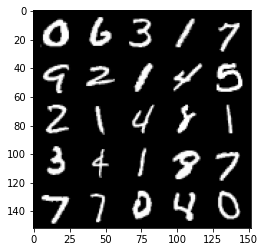

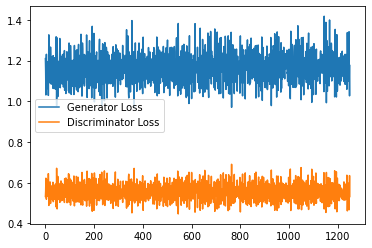

Saving fake_images-0969.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 54, step 25500: Generator loss: 1.1783664238452911, discriminator loss: 0.5547367961406707


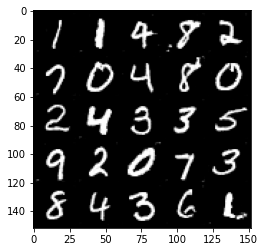

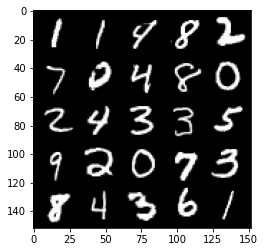

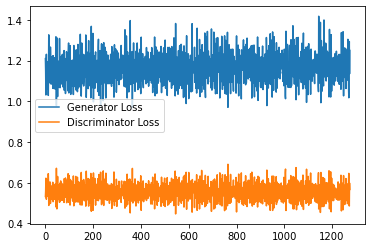

Saving fake_images-0970.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 55, step 26000: Generator loss: 1.1760668749809264, discriminator loss: 0.551177285194397


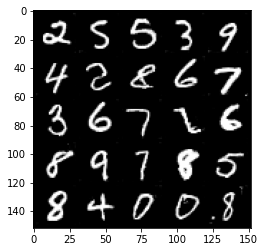

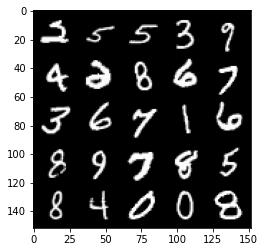

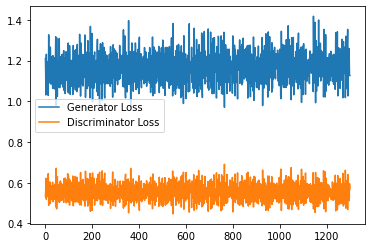

Saving fake_images-0971.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 56, step 26500: Generator loss: 1.1891703033447265, discriminator loss: 0.5478671842217445


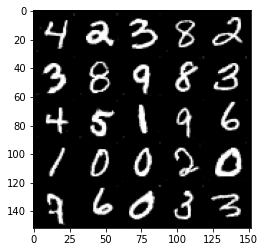

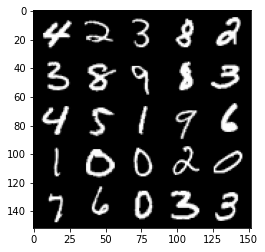

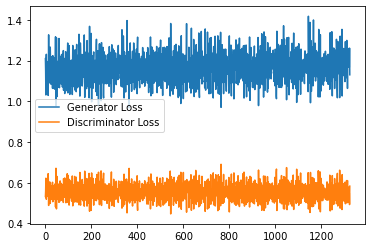

Saving fake_images-0972.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 57, step 27000: Generator loss: 1.1673322871923446, discriminator loss: 0.5574480367898941


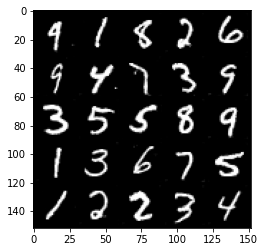

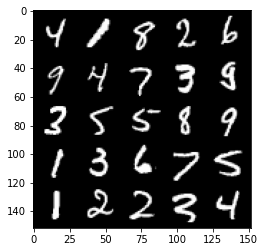

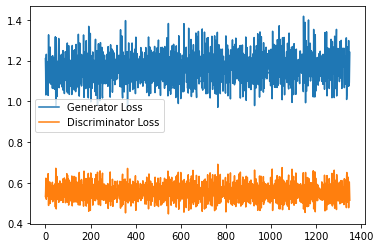

Saving fake_images-0973.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 58, step 27500: Generator loss: 1.1825625450611115, discriminator loss: 0.557760861158371


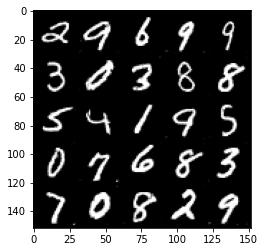

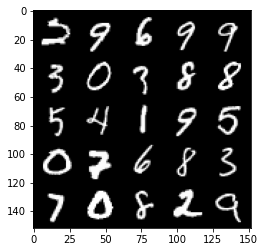

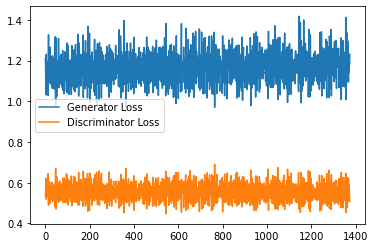

Saving fake_images-0974.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 59, step 28000: Generator loss: 1.1787843180894853, discriminator loss: 0.5535063164234162


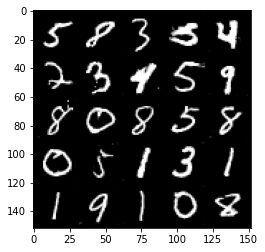

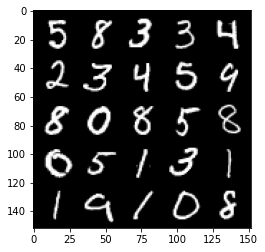

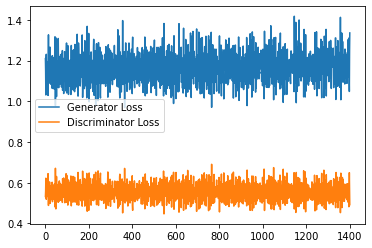

Saving fake_images-0975.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 60, step 28500: Generator loss: 1.1667514873743057, discriminator loss: 0.5529215230941772


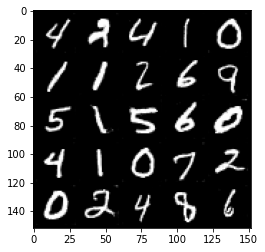

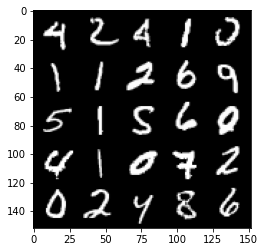

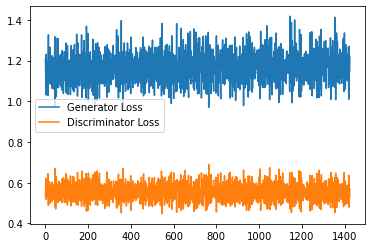

Saving fake_images-0976.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 61, step 29000: Generator loss: 1.1692464237213134, discriminator loss: 0.5542097972631455


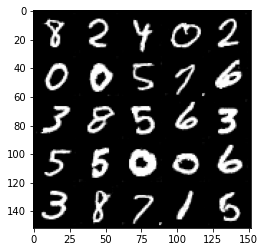

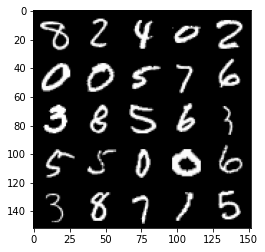

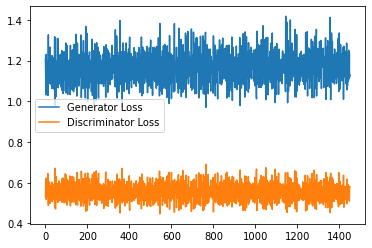

Saving fake_images-0977.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 62, step 29500: Generator loss: 1.1824728130102158, discriminator loss: 0.5504831820726395


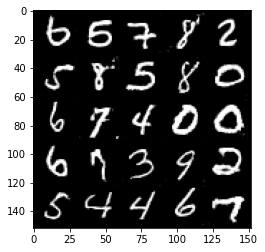

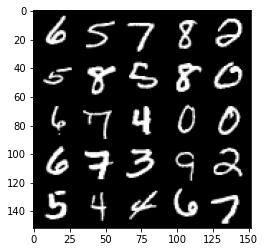

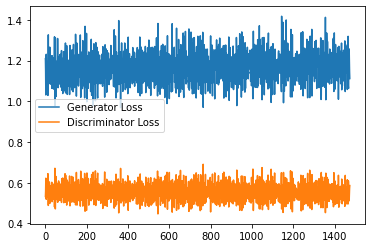

Saving fake_images-0978.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 63, step 30000: Generator loss: 1.1815209058523177, discriminator loss: 0.5485670799016953


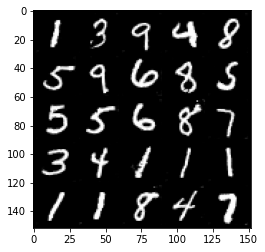

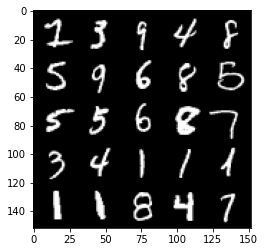

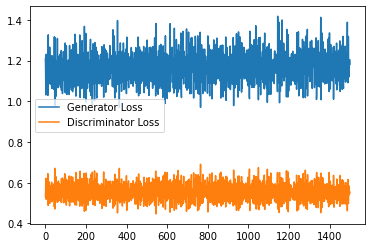

Saving fake_images-0979.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-0980.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 65, step 30500: Generator loss: 1.1865202857255936, discriminator loss: 0.5577467494606971


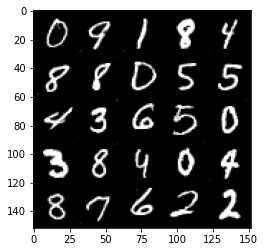

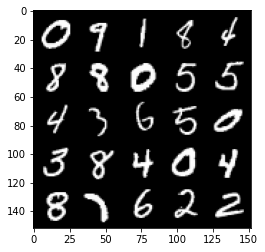

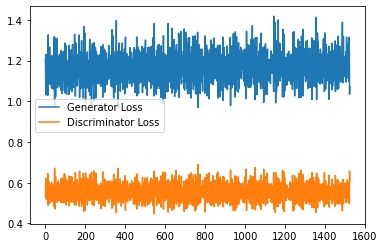

Saving fake_images-0981.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 66, step 31000: Generator loss: 1.1897404030561447, discriminator loss: 0.5487784658074379


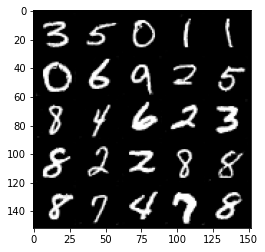

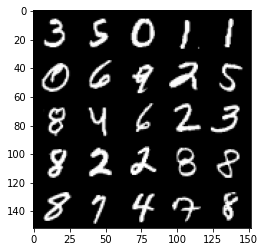

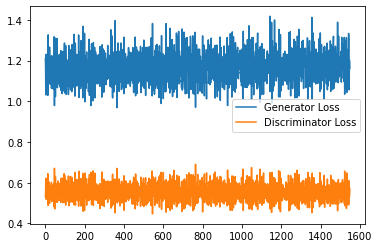

Saving fake_images-0982.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 67, step 31500: Generator loss: 1.193575789809227, discriminator loss: 0.5500616233944893


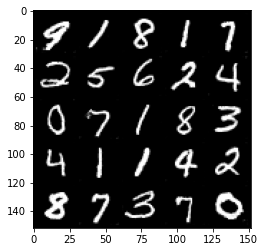

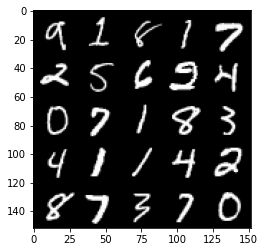

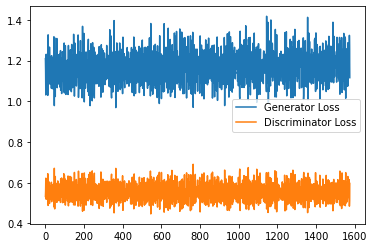

Saving fake_images-0983.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 68, step 32000: Generator loss: 1.1892723232507705, discriminator loss: 0.5527608516216278


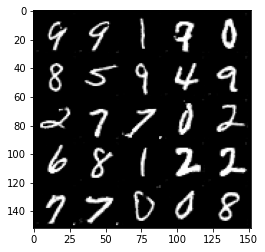

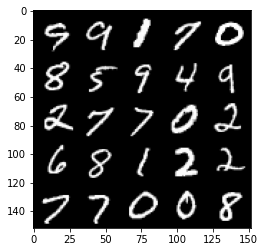

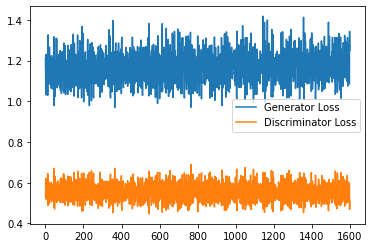

Saving fake_images-0984.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 69, step 32500: Generator loss: 1.1655949748754502, discriminator loss: 0.5563303087949752


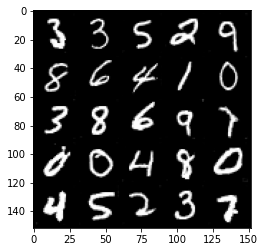

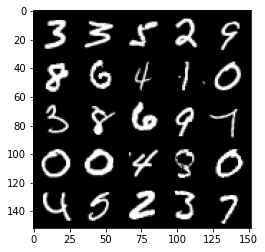

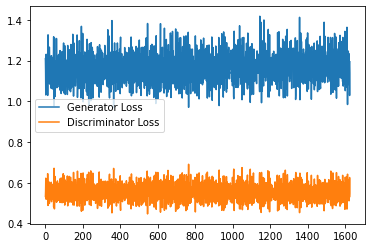

Saving fake_images-0985.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 70, step 33000: Generator loss: 1.1840046074390411, discriminator loss: 0.5497725383639336


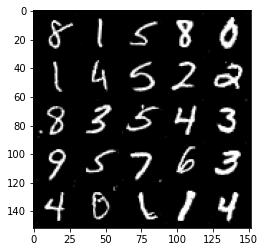

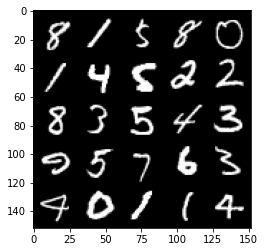

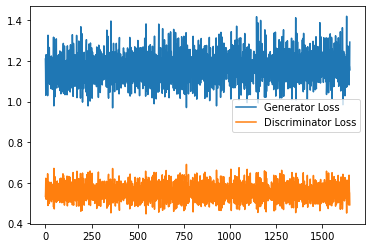

Saving fake_images-0986.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 71, step 33500: Generator loss: 1.1817915588617325, discriminator loss: 0.5540085542201996


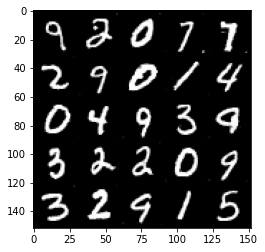

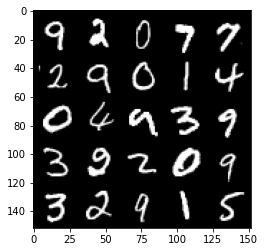

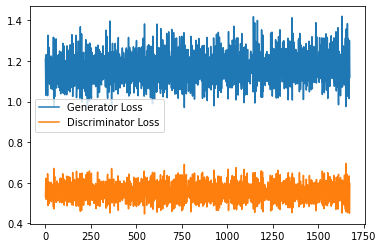

Saving fake_images-0987.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 72, step 34000: Generator loss: 1.1849080836772918, discriminator loss: 0.5507443692088128


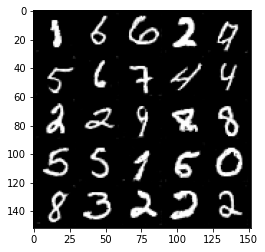

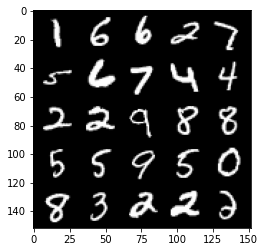

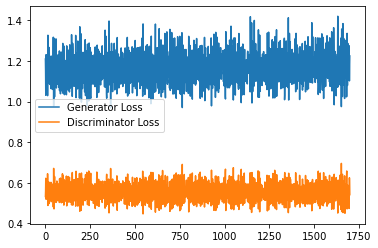

Saving fake_images-0988.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 73, step 34500: Generator loss: 1.1840771021842957, discriminator loss: 0.5505991526246071


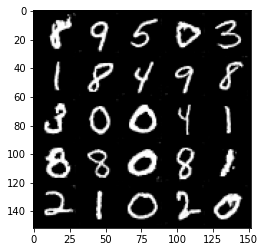

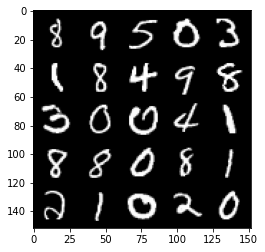

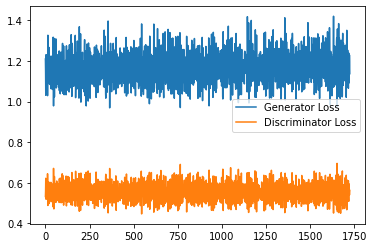

Saving fake_images-0989.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 74, step 35000: Generator loss: 1.1774468863010406, discriminator loss: 0.5509365600943565


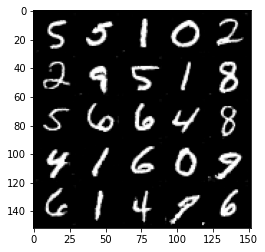

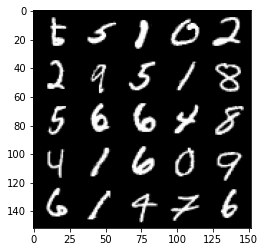

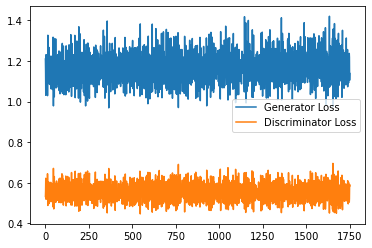

Saving fake_images-0990.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 75, step 35500: Generator loss: 1.1878450632095336, discriminator loss: 0.5456686611771584


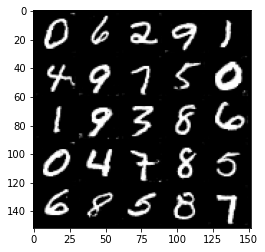

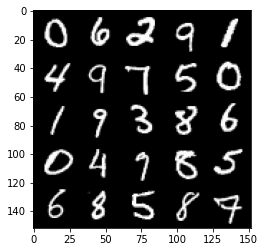

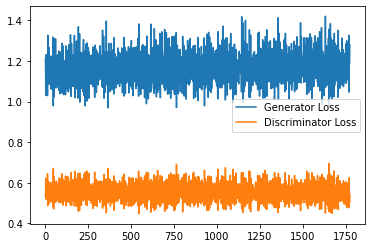

Saving fake_images-0991.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 76, step 36000: Generator loss: 1.1838464314937591, discriminator loss: 0.5499148849248886


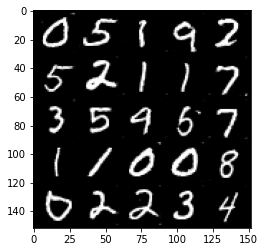

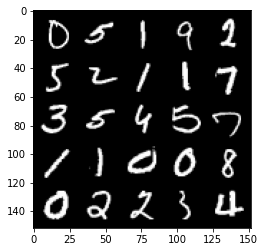

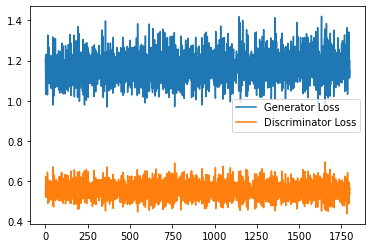

Saving fake_images-0992.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 77, step 36500: Generator loss: 1.1943689864873885, discriminator loss: 0.5505243242383003


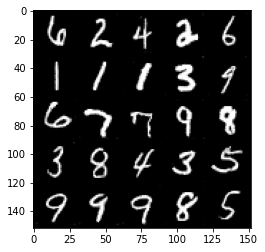

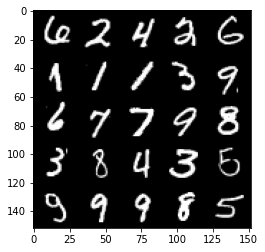

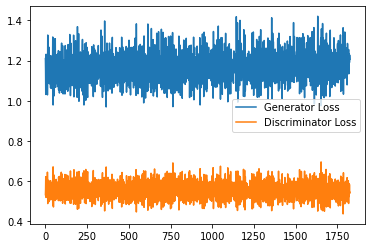

Saving fake_images-0993.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 78, step 37000: Generator loss: 1.199991528749466, discriminator loss: 0.5469233779907227


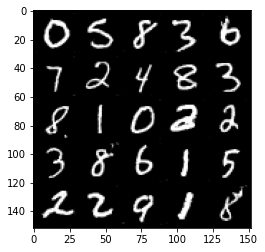

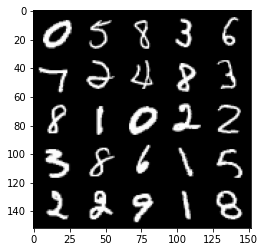

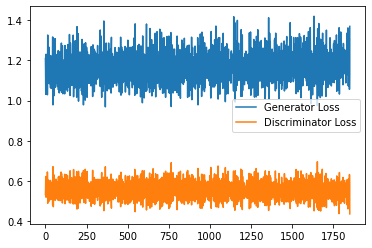

Saving fake_images-0994.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 79, step 37500: Generator loss: 1.1669490320682525, discriminator loss: 0.558843600153923


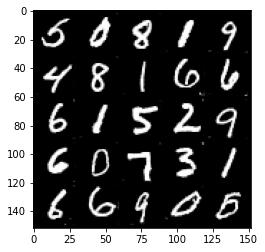

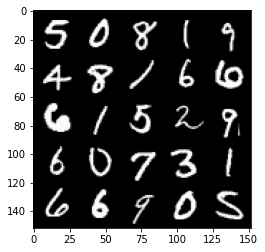

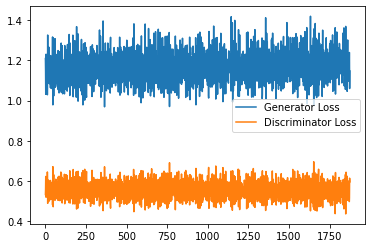

Saving fake_images-0995.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-0996.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 81, step 38000: Generator loss: 1.201808564066887, discriminator loss: 0.5522437044382096


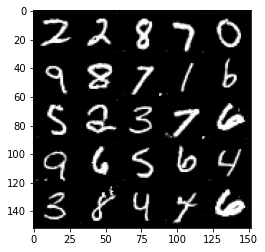

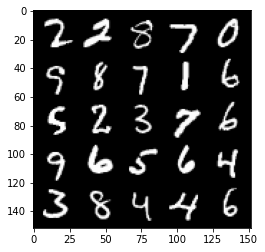

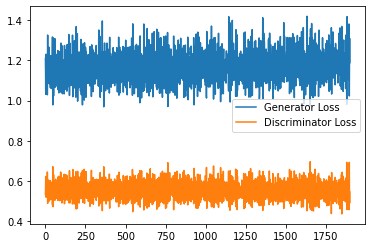

Saving fake_images-0997.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 82, step 38500: Generator loss: 1.1808632050752639, discriminator loss: 0.5589450597167015


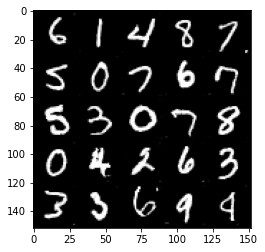

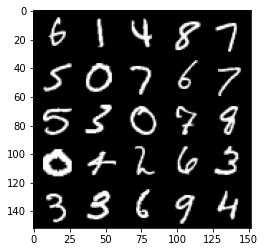

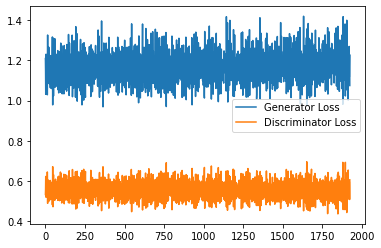

Saving fake_images-0998.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 83, step 39000: Generator loss: 1.1866816022396087, discriminator loss: 0.551771667778492


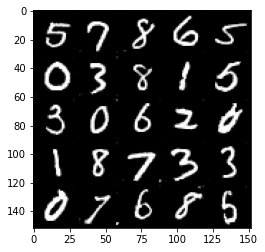

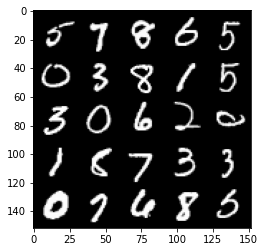

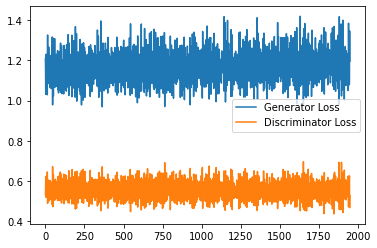

Saving fake_images-0999.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 84, step 39500: Generator loss: 1.186163124680519, discriminator loss: 0.5479571338295937


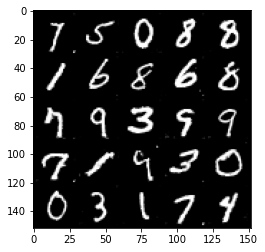

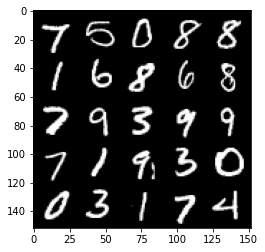

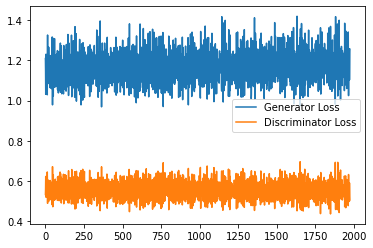

Saving fake_images-1000.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 85, step 40000: Generator loss: 1.1797895867824555, discriminator loss: 0.5557267416119576


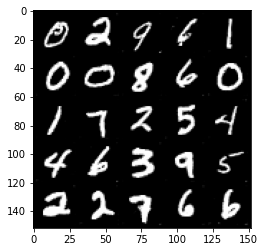

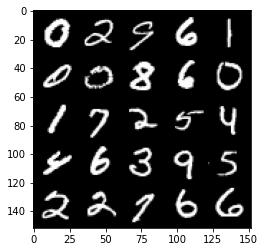

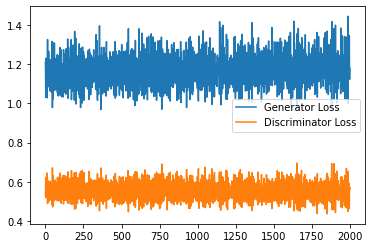

Saving fake_images-1001.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 86, step 40500: Generator loss: 1.1844817276000976, discriminator loss: 0.5485930768251419


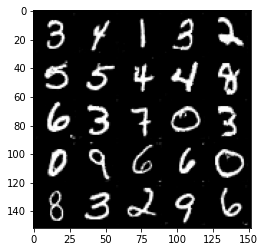

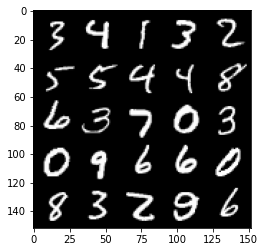

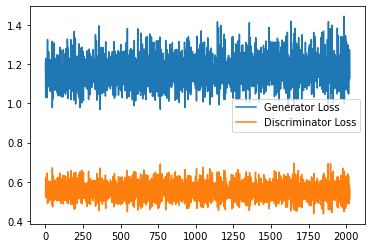

Saving fake_images-1002.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 87, step 41000: Generator loss: 1.1817135648727417, discriminator loss: 0.5529880704283714


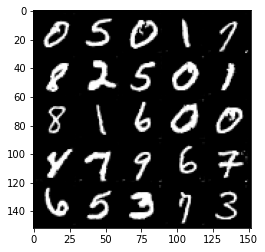

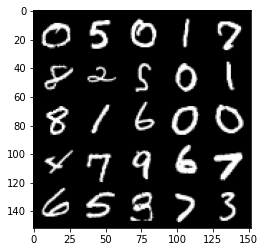

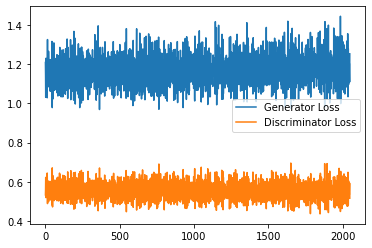

Saving fake_images-1003.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 88, step 41500: Generator loss: 1.1911181010007859, discriminator loss: 0.549575171470642


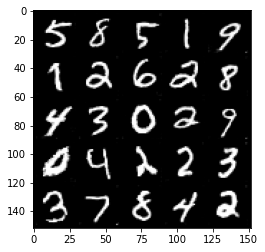

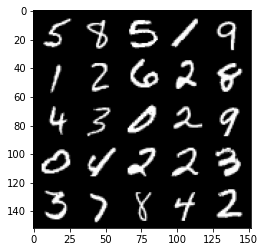

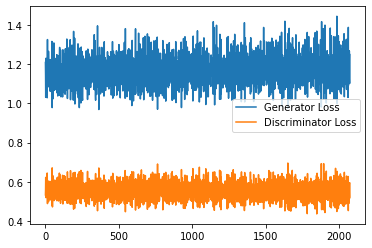

Saving fake_images-1004.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 89, step 42000: Generator loss: 1.1791390686035157, discriminator loss: 0.5518633880019188


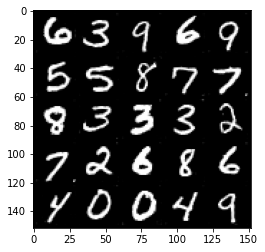

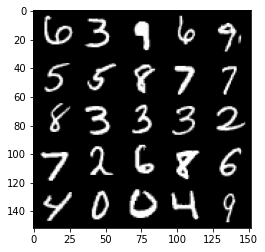

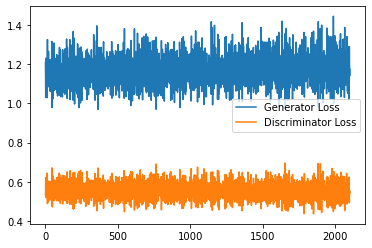

Saving fake_images-1005.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 90, step 42500: Generator loss: 1.1956812601089477, discriminator loss: 0.5476737587451935


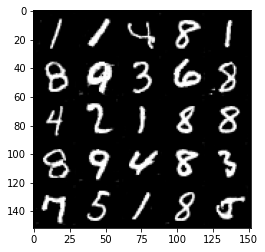

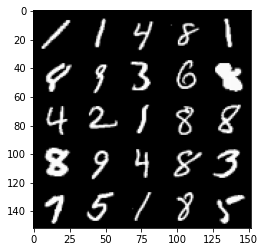

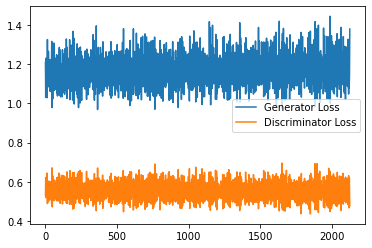

Saving fake_images-1006.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 91, step 43000: Generator loss: 1.1823968826532363, discriminator loss: 0.5574837676882743


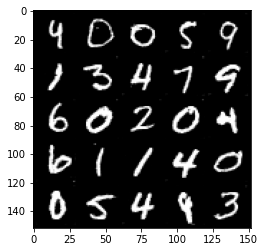

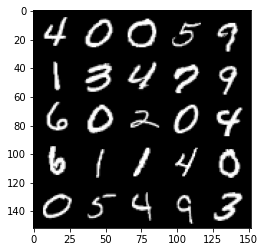

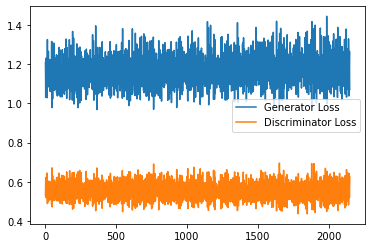

Saving fake_images-1007.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 92, step 43500: Generator loss: 1.2080870380401612, discriminator loss: 0.5431728572249412


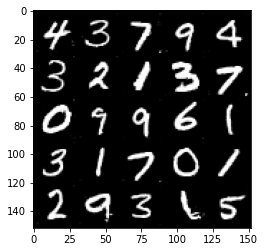

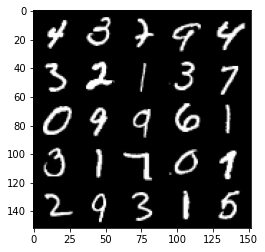

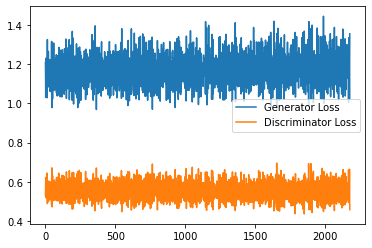

Saving fake_images-1008.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 93, step 44000: Generator loss: 1.1917075581550598, discriminator loss: 0.5540773243308067


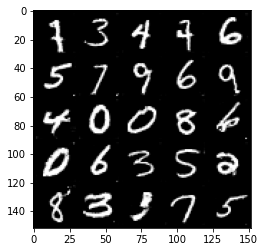

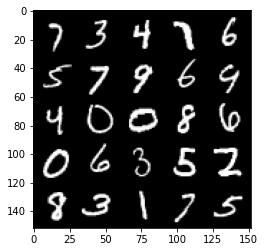

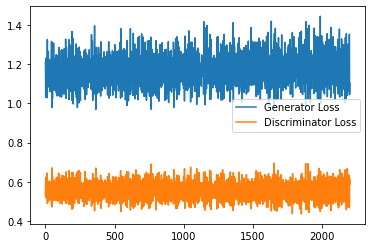

Saving fake_images-1009.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 94, step 44500: Generator loss: 1.1934043782949448, discriminator loss: 0.5469452881217003


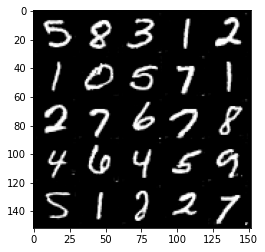

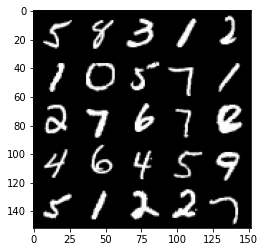

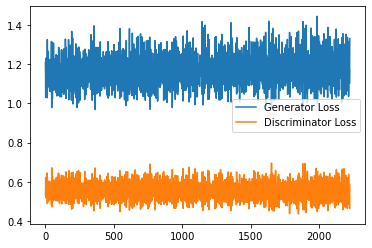

Saving fake_images-1010.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 95, step 45000: Generator loss: 1.1855999789237976, discriminator loss: 0.5512114415168762


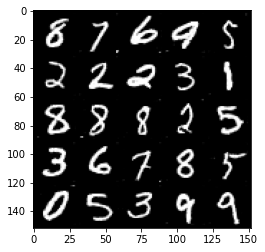

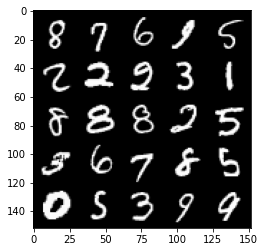

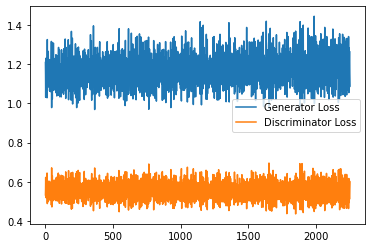

Saving fake_images-1011.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1012.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 97, step 45500: Generator loss: 1.1929785829782487, discriminator loss: 0.5467015467882156


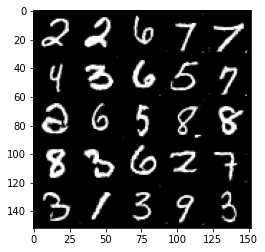

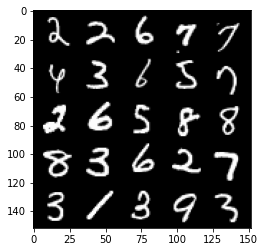

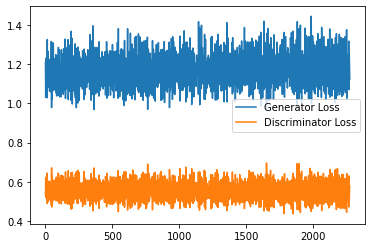

Saving fake_images-1013.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 98, step 46000: Generator loss: 1.1894913167953491, discriminator loss: 0.5470859006643295


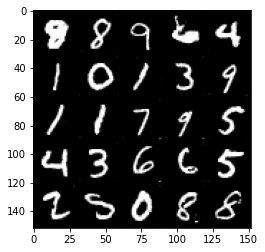

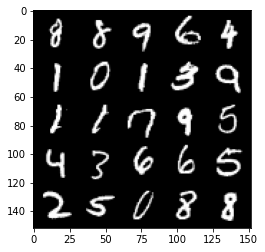

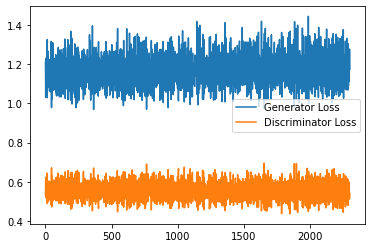

Saving fake_images-1014.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 99, step 46500: Generator loss: 1.1954421013593675, discriminator loss: 0.5473647847175598


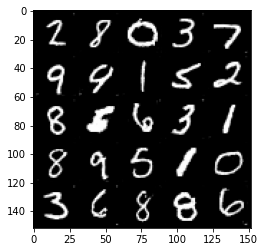

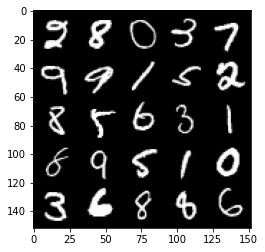

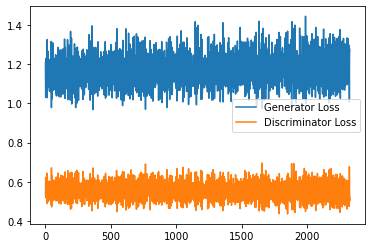

Saving fake_images-1015.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 100, step 47000: Generator loss: 1.19721728348732, discriminator loss: 0.5504019575119019


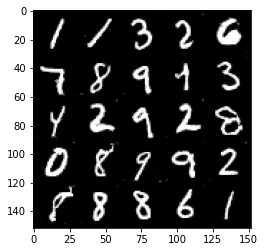

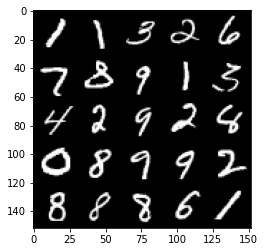

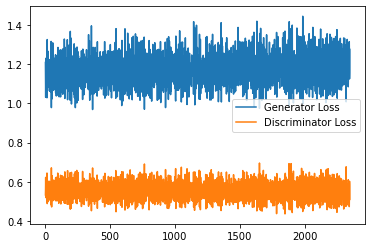

Saving fake_images-1016.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 101, step 47500: Generator loss: 1.1959364466667175, discriminator loss: 0.551852689743042


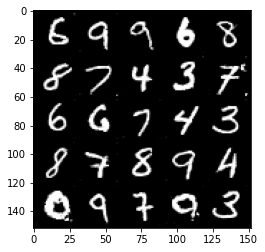

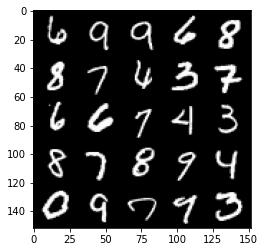

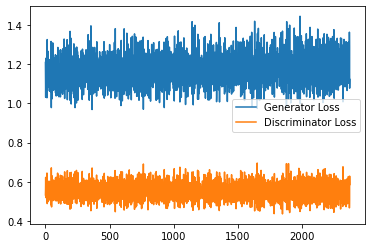

Saving fake_images-1017.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 102, step 48000: Generator loss: 1.2137633316516876, discriminator loss: 0.5450912244319915


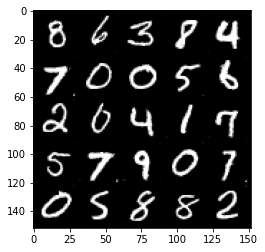

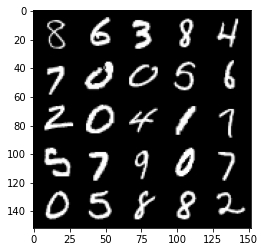

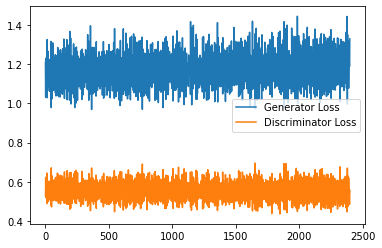

Saving fake_images-1018.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 103, step 48500: Generator loss: 1.194664074420929, discriminator loss: 0.5533847457170487


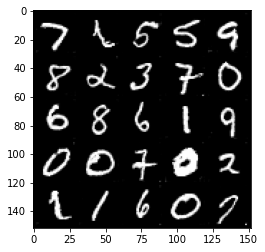

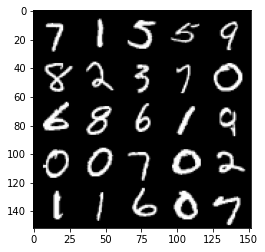

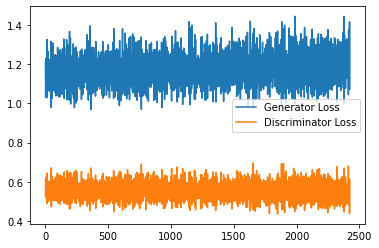

Saving fake_images-1019.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 104, step 49000: Generator loss: 1.2005046906471253, discriminator loss: 0.5445327419042587


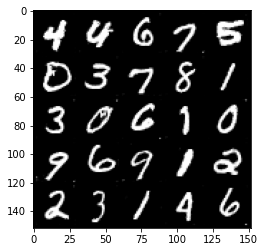

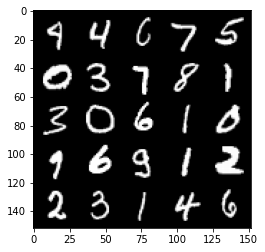

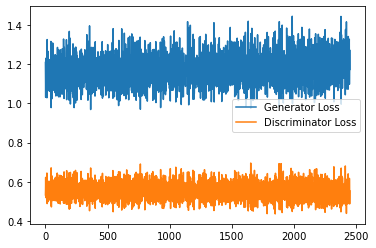

Saving fake_images-1020.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 105, step 49500: Generator loss: 1.203001812338829, discriminator loss: 0.5498835557699203


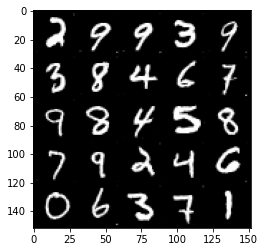

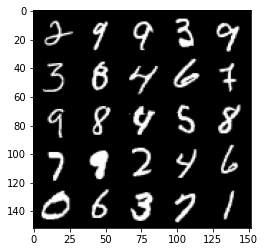

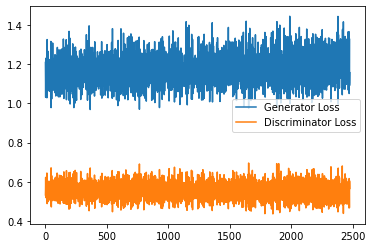

Saving fake_images-1021.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 106, step 50000: Generator loss: 1.1967907304763794, discriminator loss: 0.5457420890331268


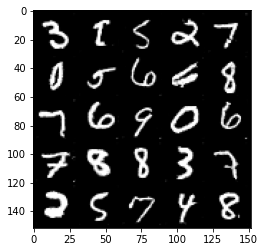

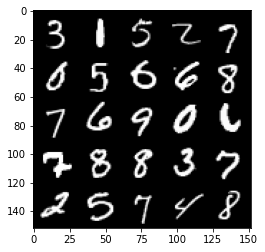

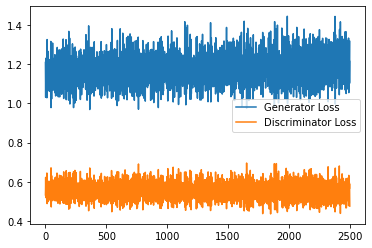

Saving fake_images-1022.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 107, step 50500: Generator loss: 1.1901986527442932, discriminator loss: 0.5496483983397484


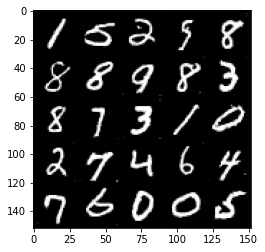

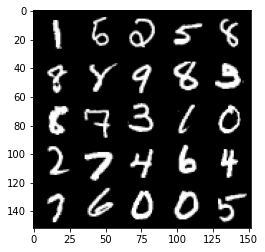

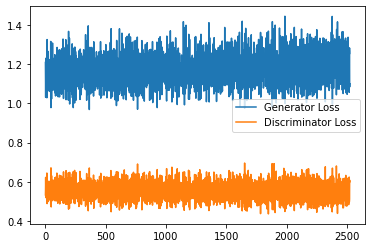

Saving fake_images-1023.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 108, step 51000: Generator loss: 1.200213392019272, discriminator loss: 0.545088679254055


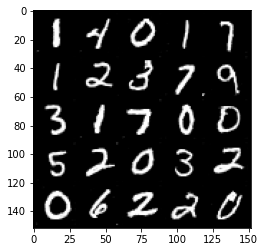

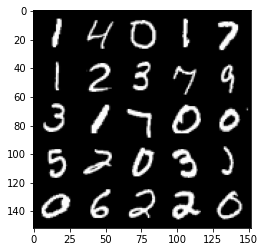

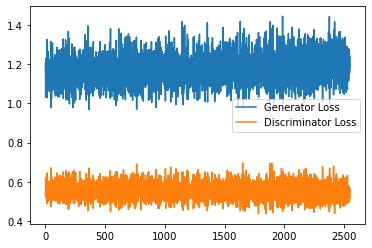

Saving fake_images-1024.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 109, step 51500: Generator loss: 1.1924516887664796, discriminator loss: 0.5474943732023239


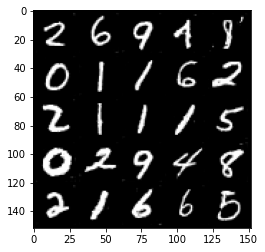

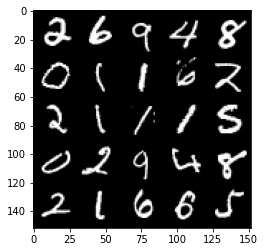

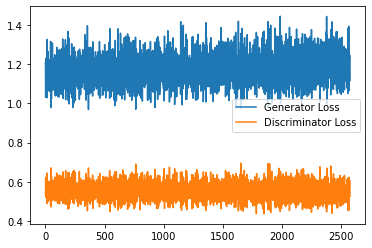

Saving fake_images-1025.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 110, step 52000: Generator loss: 1.1989357129335403, discriminator loss: 0.5468662207722664


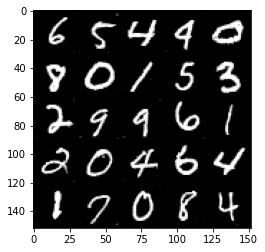

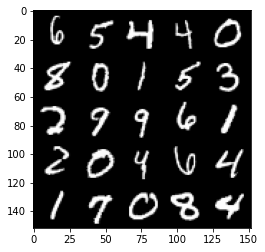

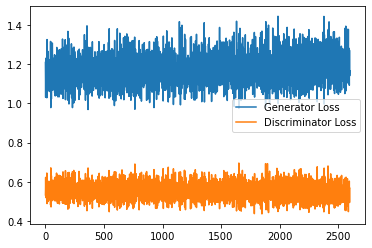

Saving fake_images-1026.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 111, step 52500: Generator loss: 1.2063542388677597, discriminator loss: 0.5472375168204308


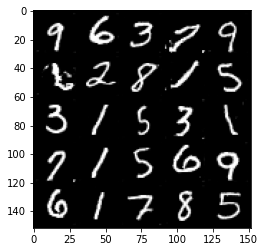

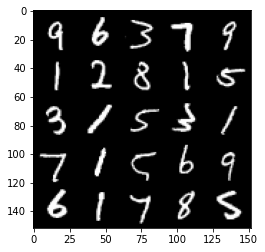

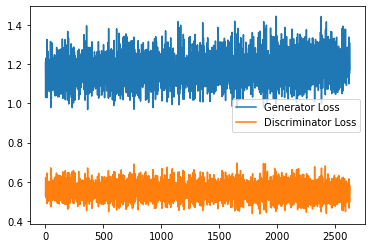

Saving fake_images-1027.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1028.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 113, step 53000: Generator loss: 1.197385416150093, discriminator loss: 0.5530271835327148


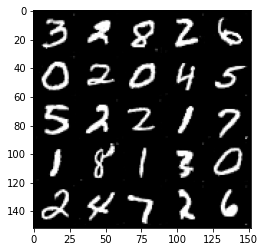

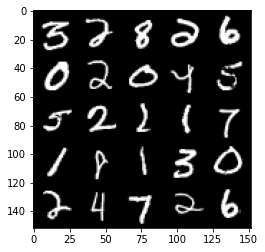

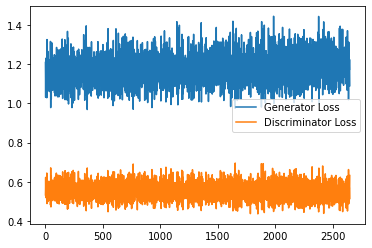

Saving fake_images-1029.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 114, step 53500: Generator loss: 1.2105403527021408, discriminator loss: 0.5441233812570572


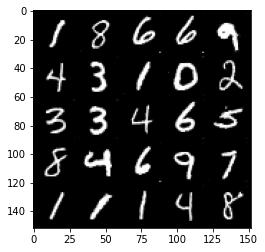

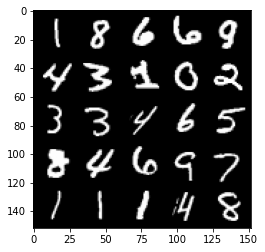

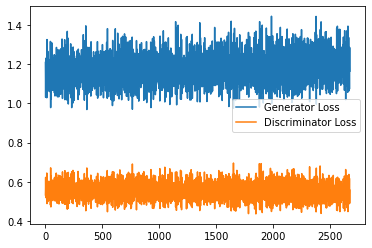

Saving fake_images-1030.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 115, step 54000: Generator loss: 1.1850931581258775, discriminator loss: 0.5460605399012566


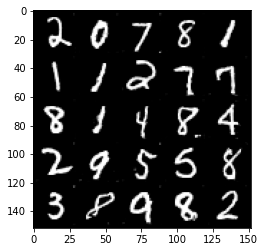

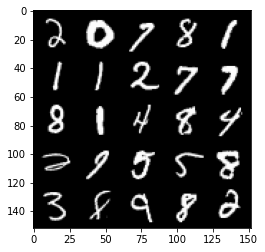

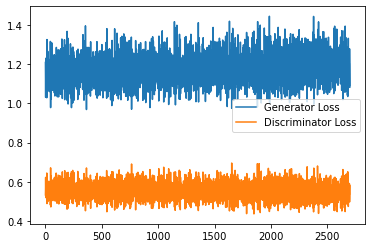

Saving fake_images-1031.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 116, step 54500: Generator loss: 1.2026419821977616, discriminator loss: 0.5489166332483292


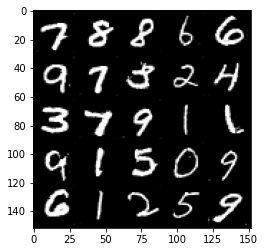

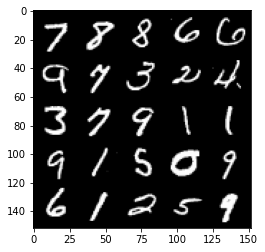

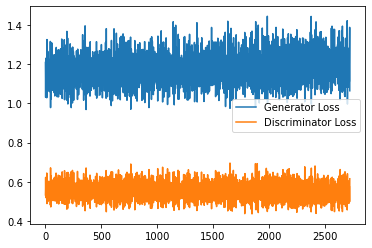

Saving fake_images-1032.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 117, step 55000: Generator loss: 1.1938074324131012, discriminator loss: 0.544940367758274


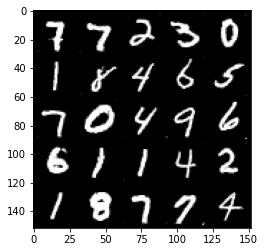

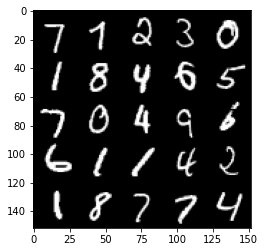

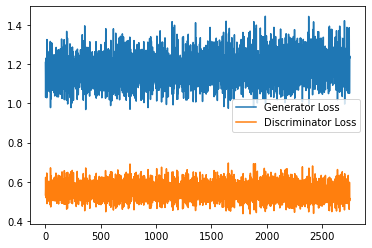

Saving fake_images-1033.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 118, step 55500: Generator loss: 1.2055881164073945, discriminator loss: 0.545214595079422


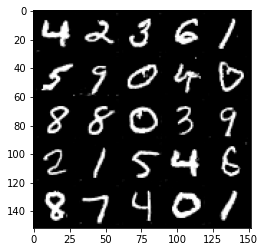

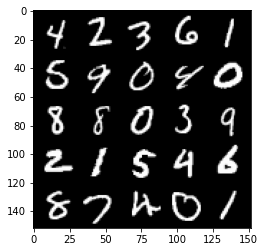

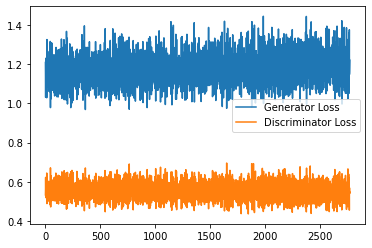

Saving fake_images-1034.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 119, step 56000: Generator loss: 1.2025657695531846, discriminator loss: 0.5449173130393028


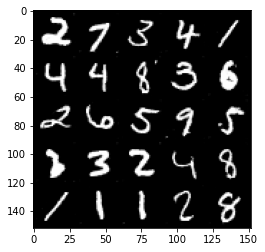

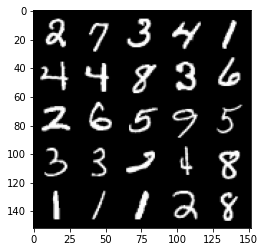

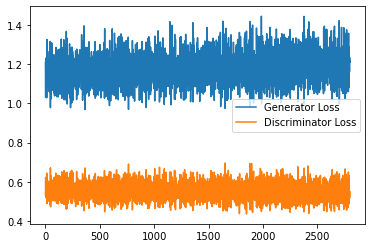

Saving fake_images-1035.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 120, step 56500: Generator loss: 1.200859153866768, discriminator loss: 0.5516634366512299


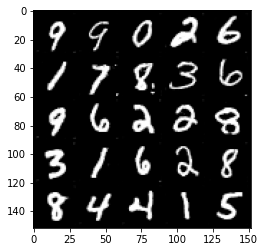

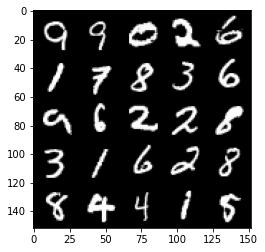

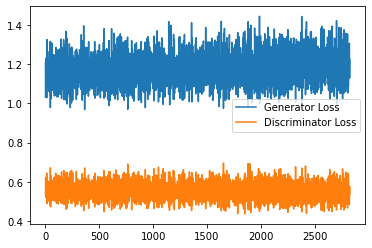

Saving fake_images-1036.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 121, step 57000: Generator loss: 1.2114555423259734, discriminator loss: 0.5409082105159759


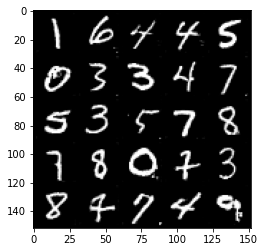

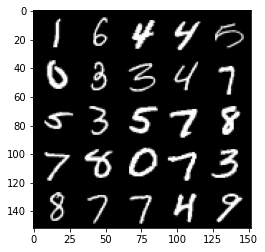

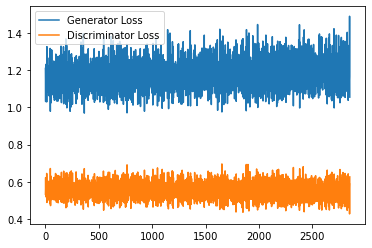

Saving fake_images-1037.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 122, step 57500: Generator loss: 1.212849445462227, discriminator loss: 0.5445787667036056


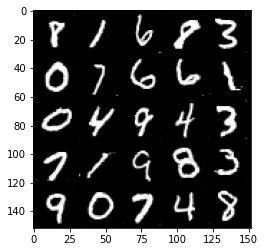

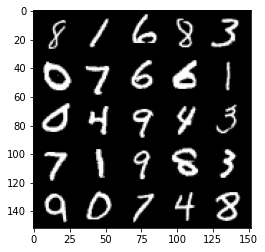

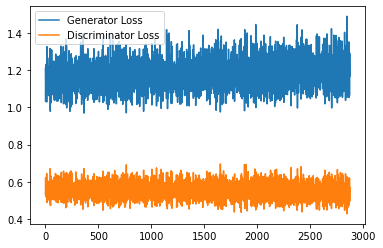

Saving fake_images-1038.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 123, step 58000: Generator loss: 1.217594509243965, discriminator loss: 0.5443427701592445


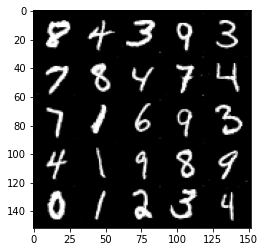

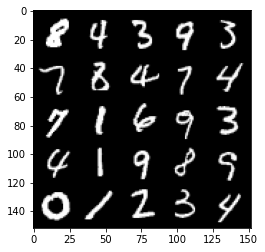

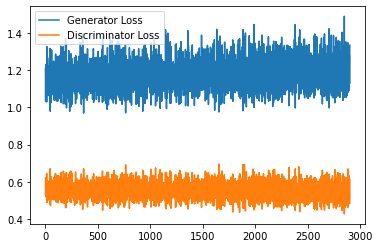

Saving fake_images-1039.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 124, step 58500: Generator loss: 1.2079045065641403, discriminator loss: 0.5451478961110116


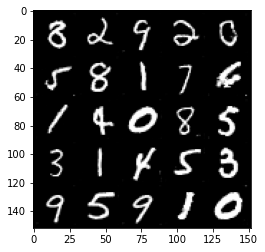

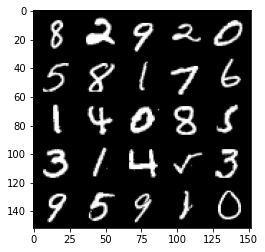

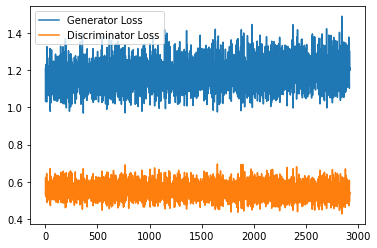

Saving fake_images-1040.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 125, step 59000: Generator loss: 1.2014299113750457, discriminator loss: 0.54736773198843


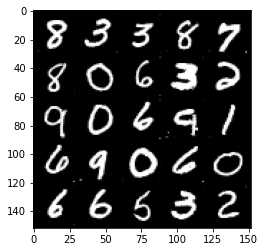

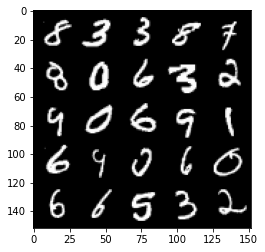

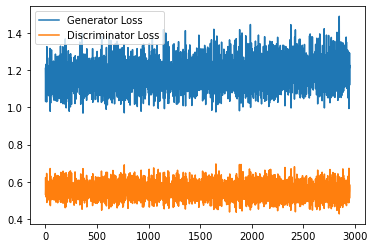

Saving fake_images-1041.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 126, step 59500: Generator loss: 1.195980169415474, discriminator loss: 0.5515054658055305


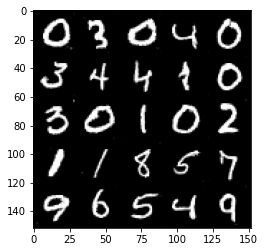

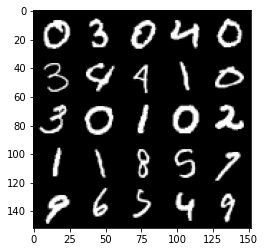

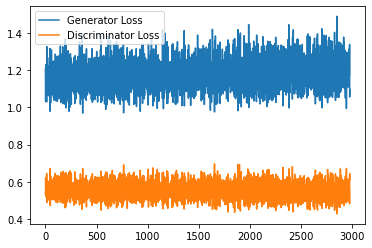

Saving fake_images-1042.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 127, step 60000: Generator loss: 1.2099927141666413, discriminator loss: 0.5429385778307915


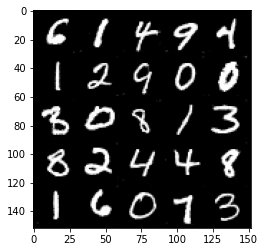

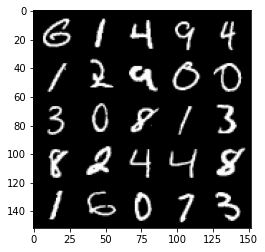

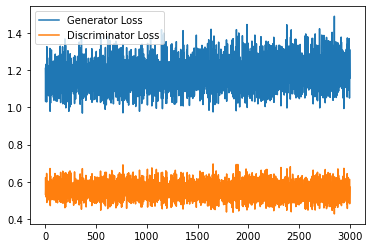

Saving fake_images-1043.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 128, step 60500: Generator loss: 1.2128610253334045, discriminator loss: 0.5443237535357476


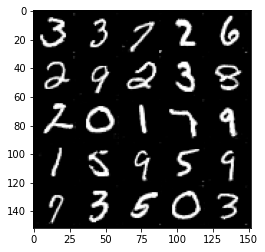

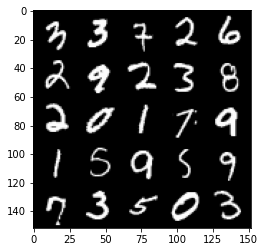

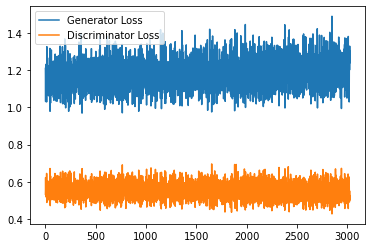

Saving fake_images-1044.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1045.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 130, step 61000: Generator loss: 1.2093019678592682, discriminator loss: 0.5456010027527809


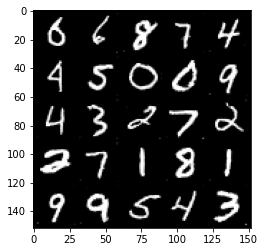

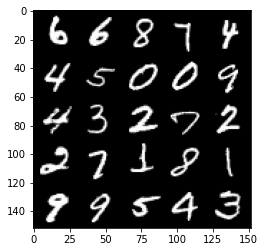

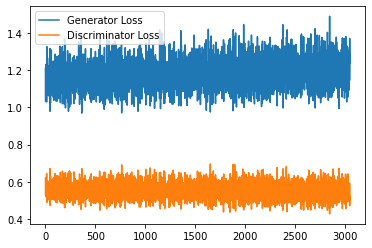

Saving fake_images-1046.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 131, step 61500: Generator loss: 1.1974782100915908, discriminator loss: 0.5506330731511117


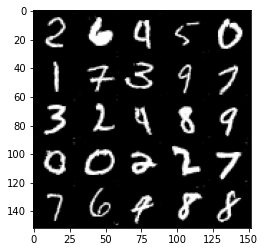

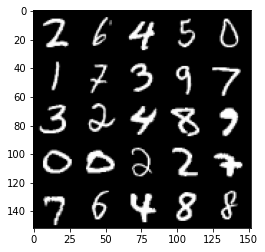

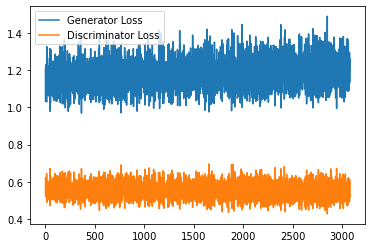

Saving fake_images-1047.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 132, step 62000: Generator loss: 1.2034949853420258, discriminator loss: 0.5440652825832367


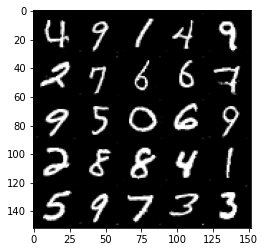

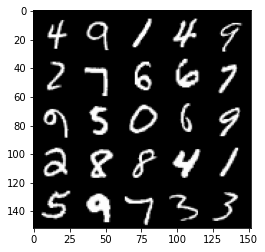

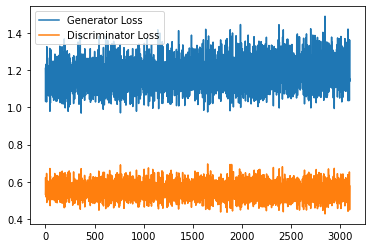

Saving fake_images-1048.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 133, step 62500: Generator loss: 1.2073081700801849, discriminator loss: 0.5446024813652038


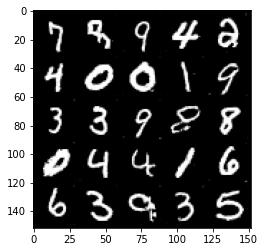

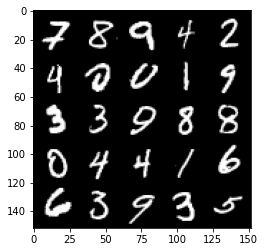

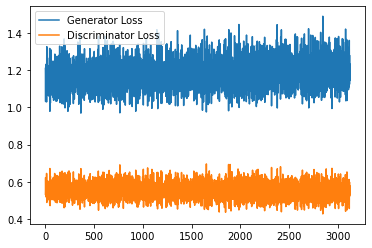

Saving fake_images-1049.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 134, step 63000: Generator loss: 1.21305765914917, discriminator loss: 0.5475278713703156


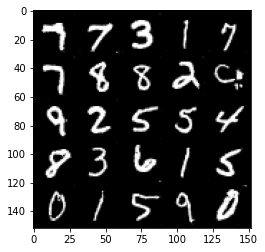

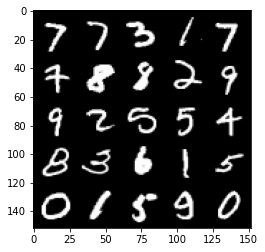

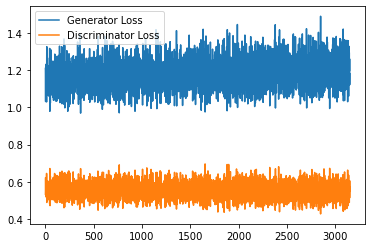

Saving fake_images-1050.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 135, step 63500: Generator loss: 1.214038947224617, discriminator loss: 0.5430169763565064


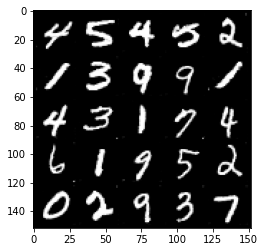

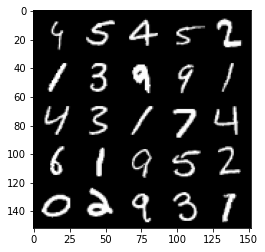

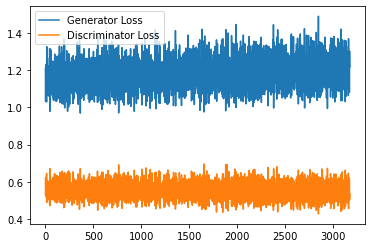

Saving fake_images-1051.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 136, step 64000: Generator loss: 1.206036850810051, discriminator loss: 0.546912536084652


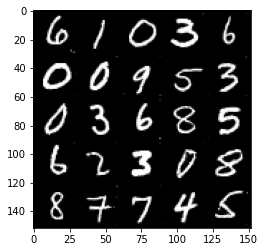

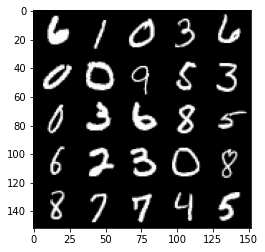

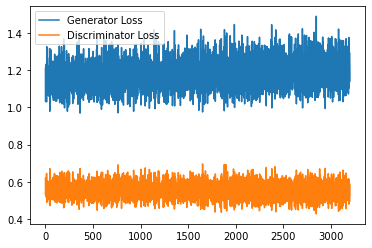

Saving fake_images-1052.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 137, step 64500: Generator loss: 1.2084788661003112, discriminator loss: 0.5516957859396935


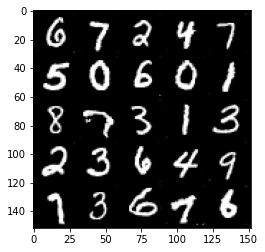

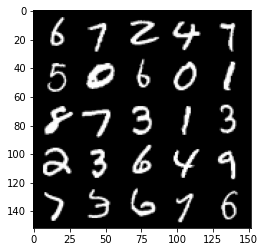

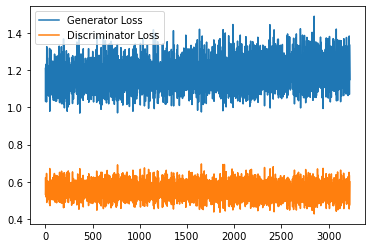

Saving fake_images-1053.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 138, step 65000: Generator loss: 1.203203196644783, discriminator loss: 0.5492332659363747


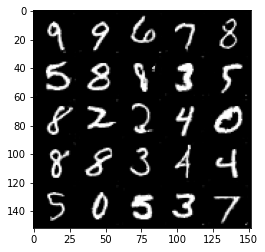

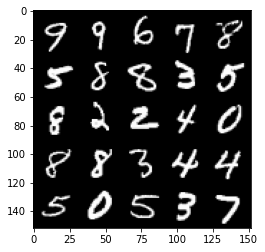

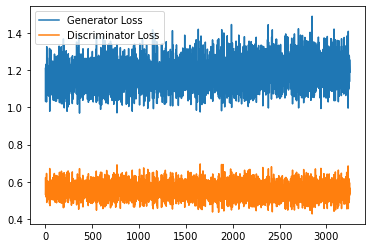

Saving fake_images-1054.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 139, step 65500: Generator loss: 1.2071381237506866, discriminator loss: 0.5476800585985184


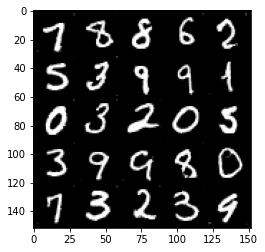

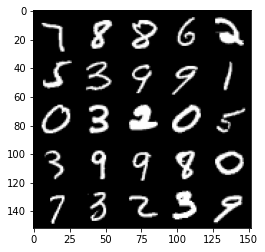

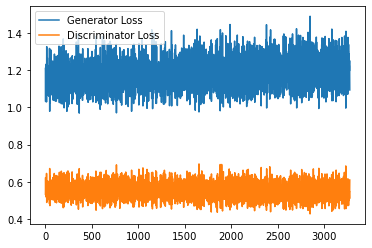

Saving fake_images-1055.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 140, step 66000: Generator loss: 1.2088835341930388, discriminator loss: 0.5484115819334984


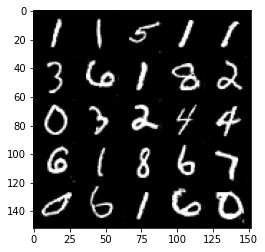

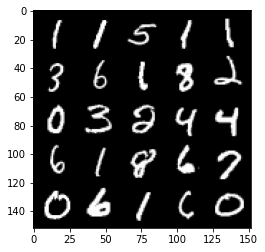

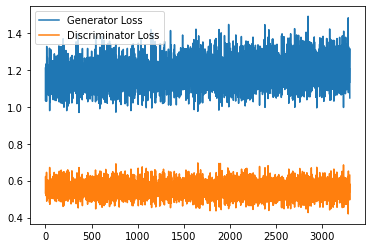

Saving fake_images-1056.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 141, step 66500: Generator loss: 1.215708942770958, discriminator loss: 0.5414186397790909


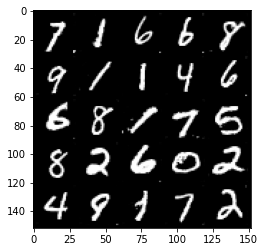

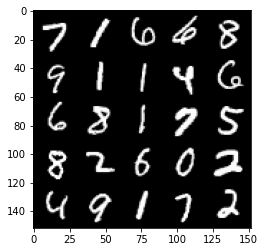

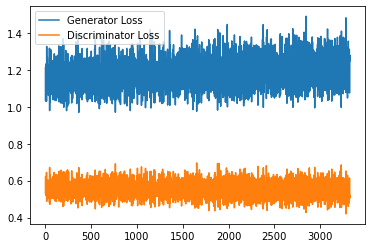

Saving fake_images-1057.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 142, step 67000: Generator loss: 1.2104958798885346, discriminator loss: 0.5435300892591477


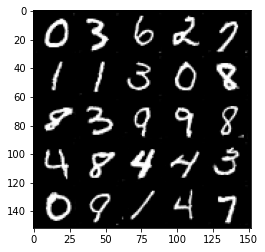

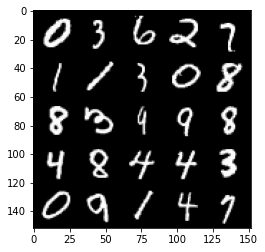

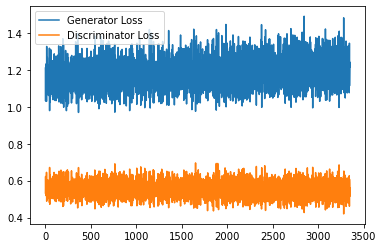

Saving fake_images-1058.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 143, step 67500: Generator loss: 1.211059157371521, discriminator loss: 0.5401219567656517


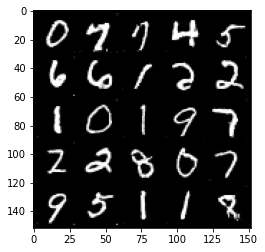

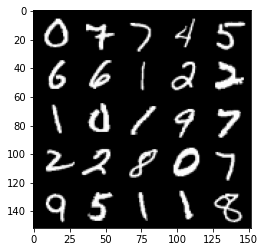

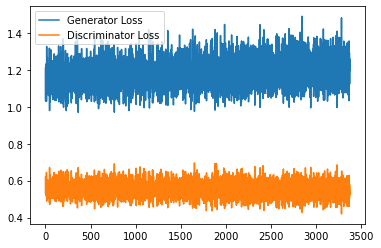

Saving fake_images-1059.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 144, step 68000: Generator loss: 1.2060776587724686, discriminator loss: 0.543385159432888


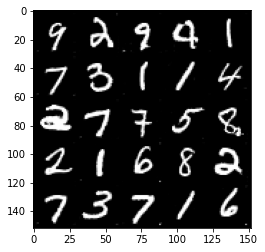

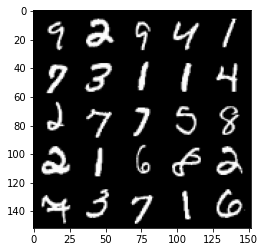

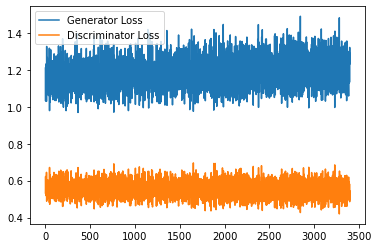

Saving fake_images-1060.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1061.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 146, step 68500: Generator loss: 1.2204421586990357, discriminator loss: 0.5441129295825958


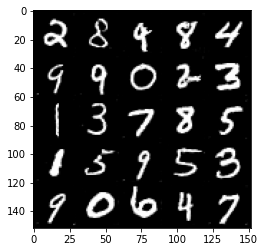

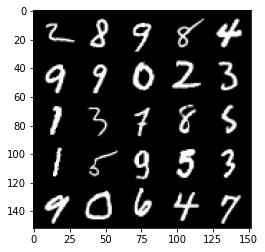

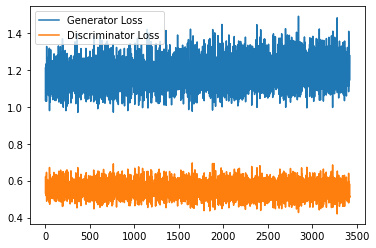

Saving fake_images-1062.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 147, step 69000: Generator loss: 1.2222351435422898, discriminator loss: 0.5430963654518127


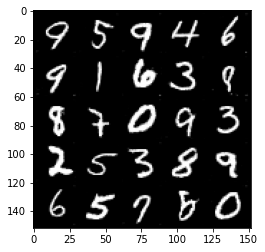

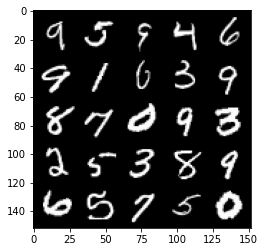

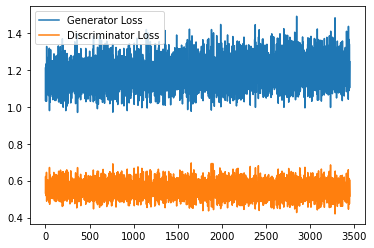

Saving fake_images-1063.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 148, step 69500: Generator loss: 1.2239966354370118, discriminator loss: 0.541718263566494


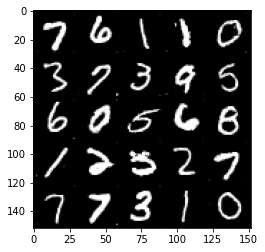

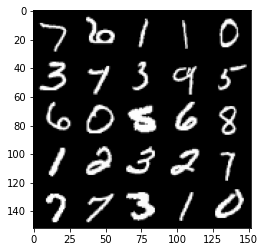

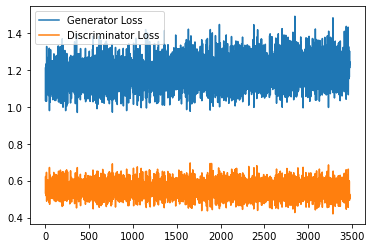

Saving fake_images-1064.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 149, step 70000: Generator loss: 1.2264892692565919, discriminator loss: 0.5444479450583458


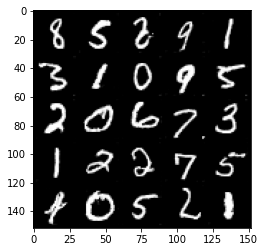

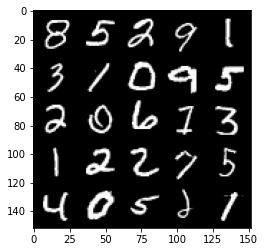

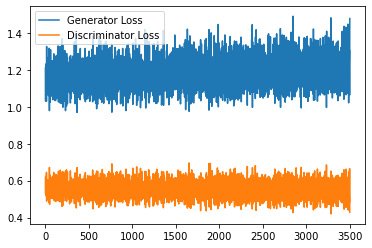

Saving fake_images-1065.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 150, step 70500: Generator loss: 1.2062693910598754, discriminator loss: 0.5513705211877823


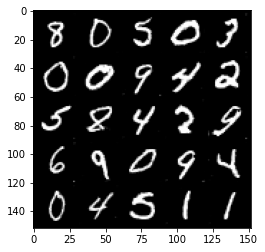

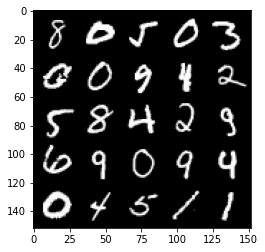

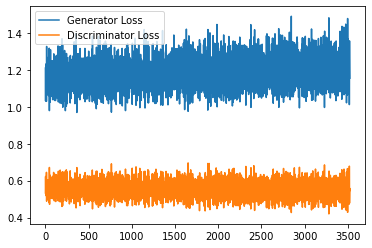

Saving fake_images-1066.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 151, step 71000: Generator loss: 1.2059061952829362, discriminator loss: 0.5422027292847633


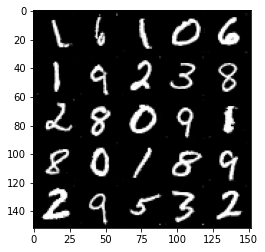

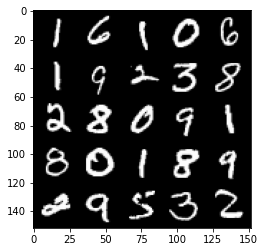

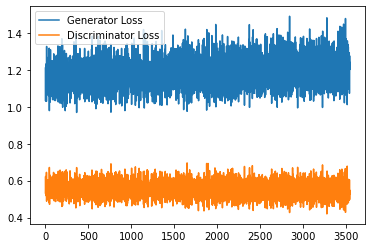

Saving fake_images-1067.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 152, step 71500: Generator loss: 1.220218027472496, discriminator loss: 0.5463373843431473


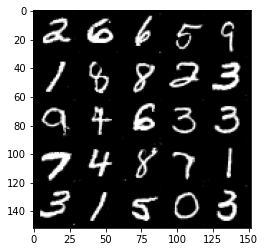

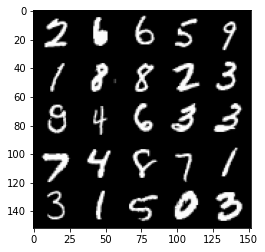

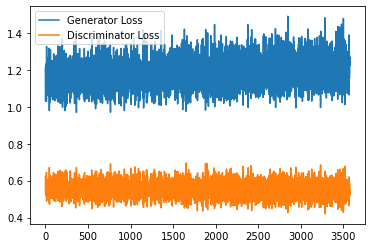

Saving fake_images-1068.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 153, step 72000: Generator loss: 1.2143737199306488, discriminator loss: 0.5475968272089958


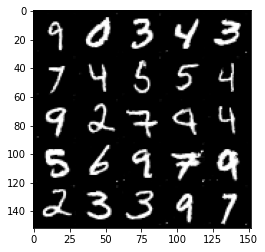

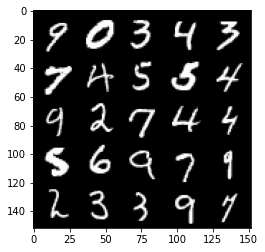

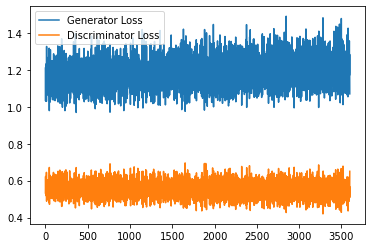

Saving fake_images-1069.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 154, step 72500: Generator loss: 1.2202200008630752, discriminator loss: 0.5400454202890396


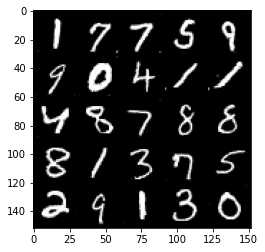

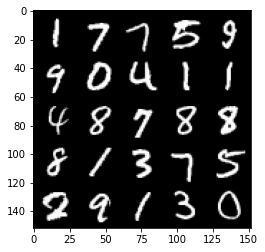

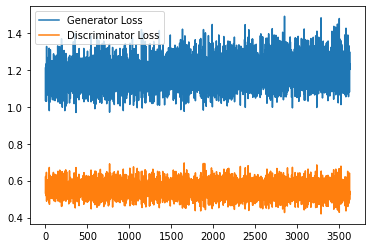

Saving fake_images-1070.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 155, step 73000: Generator loss: 1.2068692220449448, discriminator loss: 0.5432230124473572


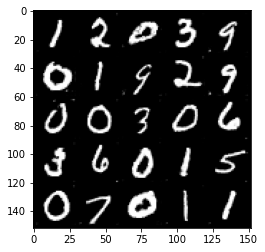

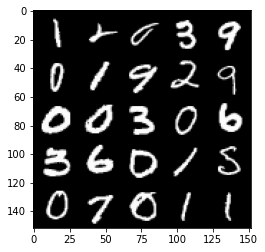

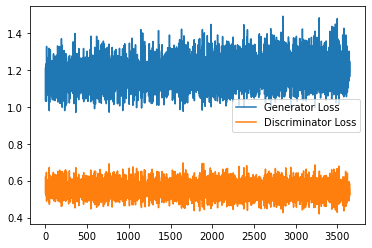

Saving fake_images-1071.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 156, step 73500: Generator loss: 1.2108534762859344, discriminator loss: 0.5449712311029434


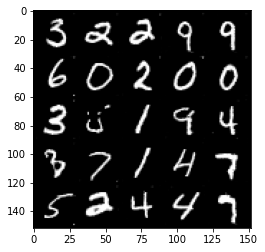

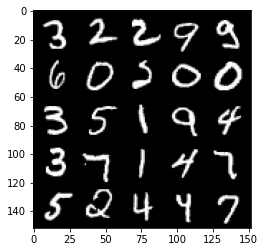

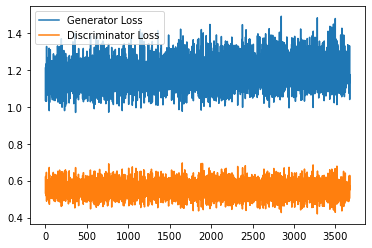

Saving fake_images-1072.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 157, step 74000: Generator loss: 1.2281420185565948, discriminator loss: 0.5385721181631088


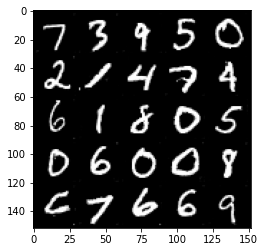

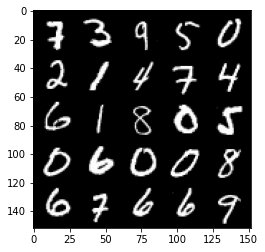

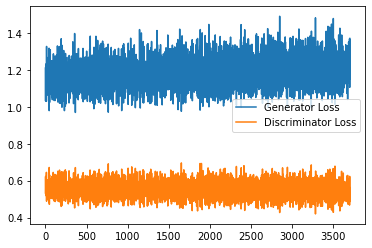

Saving fake_images-1073.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 158, step 74500: Generator loss: 1.2273700848817826, discriminator loss: 0.5407832030653954


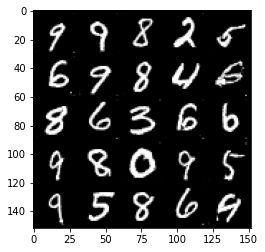

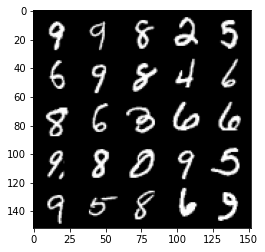

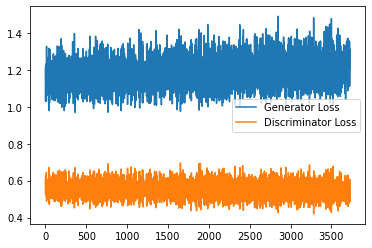

Saving fake_images-1074.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 159, step 75000: Generator loss: 1.2105083364248275, discriminator loss: 0.5443801325559616


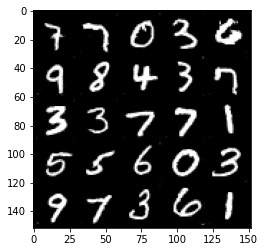

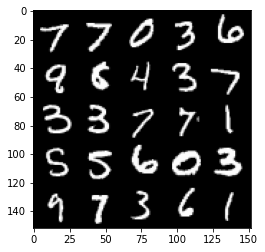

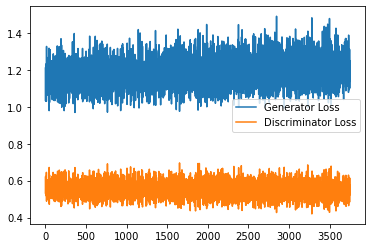

Saving fake_images-1075.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 160, step 75500: Generator loss: 1.2318202846050263, discriminator loss: 0.5389797081947326


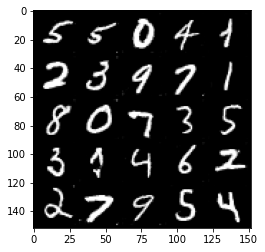

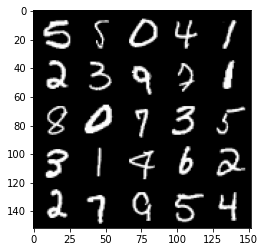

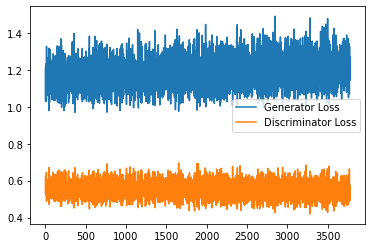

Saving fake_images-1076.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1077.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 162, step 76000: Generator loss: 1.221918380498886, discriminator loss: 0.543201978623867


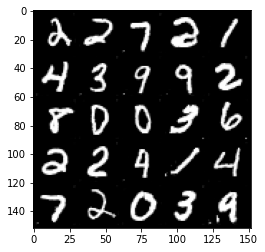

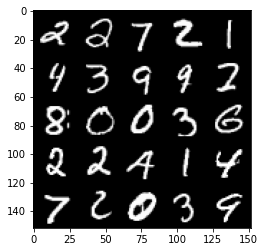

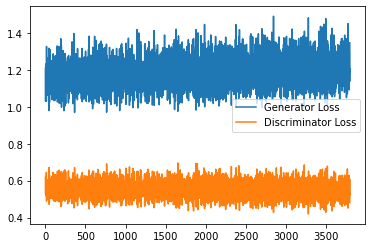

Saving fake_images-1078.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 163, step 76500: Generator loss: 1.2126248930692674, discriminator loss: 0.5458878825902939


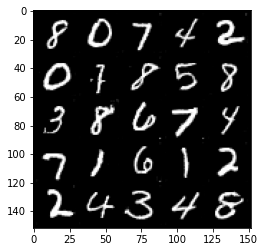

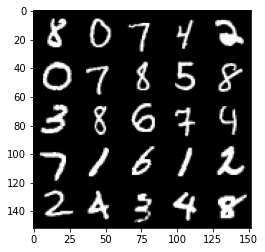

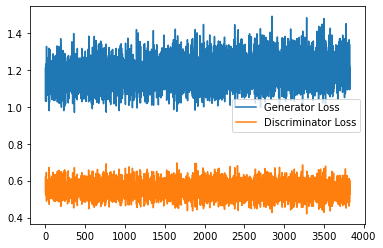

Saving fake_images-1079.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 164, step 77000: Generator loss: 1.207435403227806, discriminator loss: 0.5388276014328003


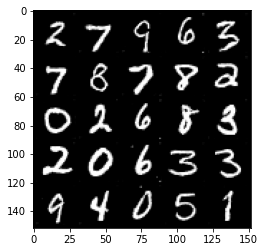

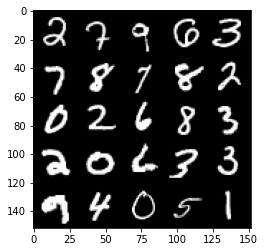

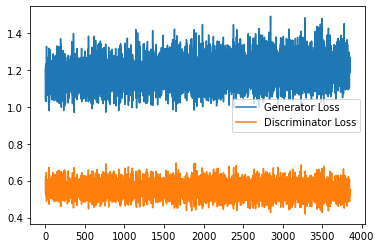

Saving fake_images-1080.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 165, step 77500: Generator loss: 1.2096674271821977, discriminator loss: 0.5446211542487145


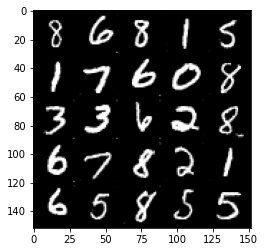

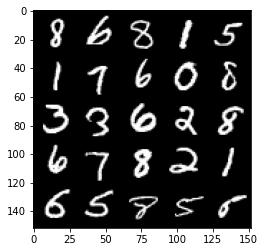

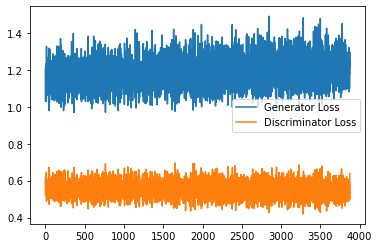

Saving fake_images-1081.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 166, step 78000: Generator loss: 1.2324359601736068, discriminator loss: 0.5420254118442536


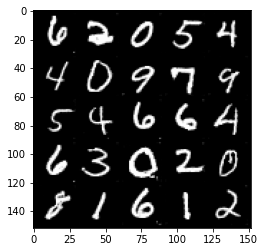

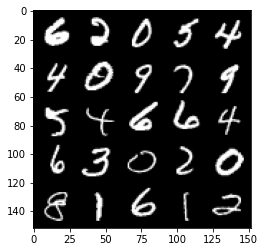

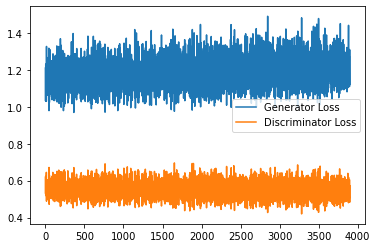

Saving fake_images-1082.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 167, step 78500: Generator loss: 1.2114312191009522, discriminator loss: 0.5487076639533043


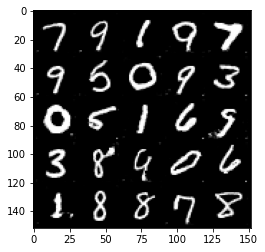

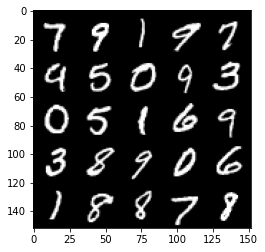

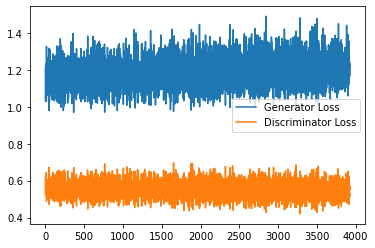

Saving fake_images-1083.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 168, step 79000: Generator loss: 1.221372375011444, discriminator loss: 0.5468500540852547


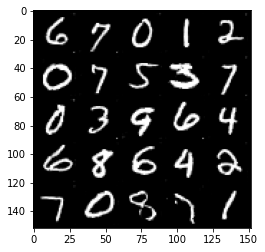

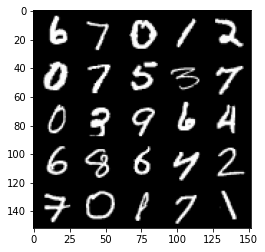

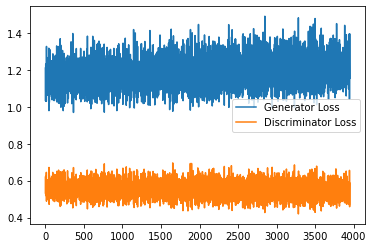

Saving fake_images-1084.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 169, step 79500: Generator loss: 1.2176886959075928, discriminator loss: 0.5407034963965416


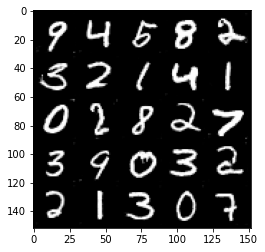

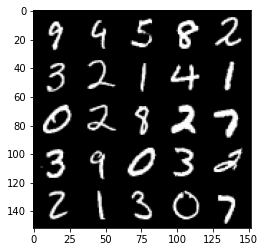

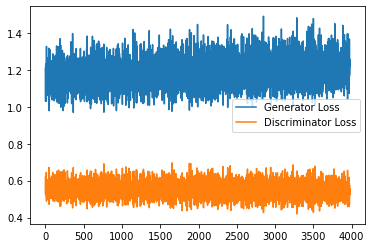

Saving fake_images-1085.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 170, step 80000: Generator loss: 1.2276398949623109, discriminator loss: 0.5476746819019318


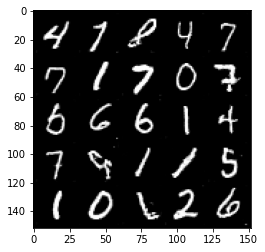

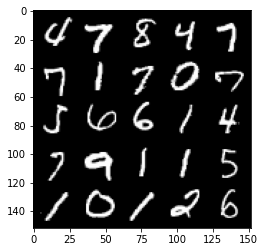

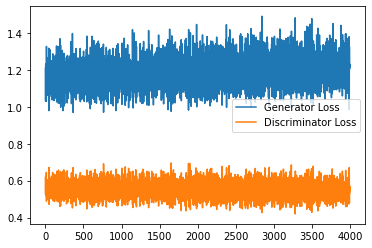

Saving fake_images-1086.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 171, step 80500: Generator loss: 1.211804779291153, discriminator loss: 0.5415718749761581


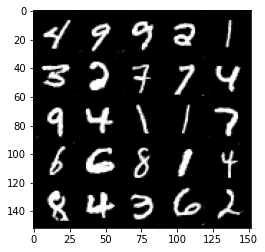

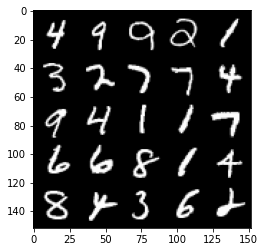

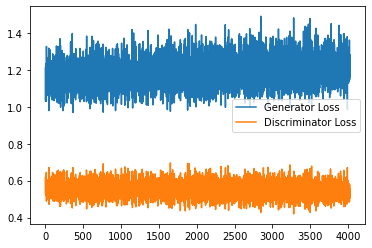

Saving fake_images-1087.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 172, step 81000: Generator loss: 1.2210079563856124, discriminator loss: 0.5447354635000229


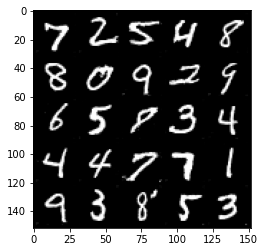

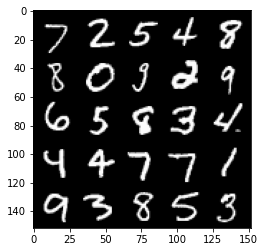

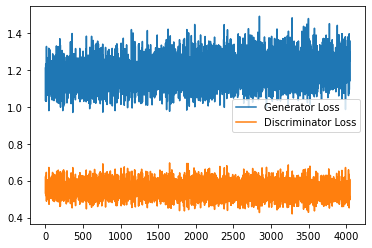

Saving fake_images-1088.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 173, step 81500: Generator loss: 1.211793989300728, discriminator loss: 0.5477643493413925


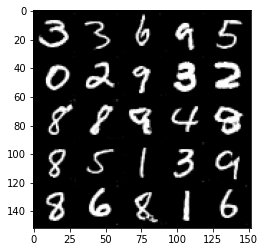

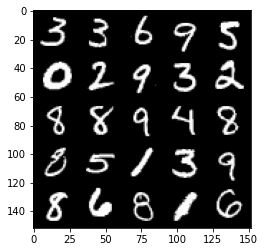

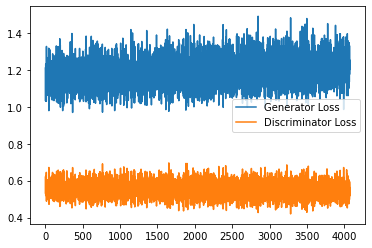

Saving fake_images-1089.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 174, step 82000: Generator loss: 1.217063789486885, discriminator loss: 0.5414141703248024


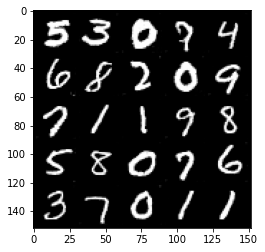

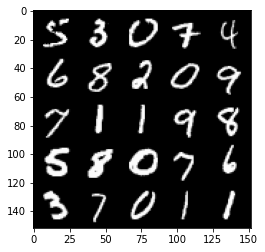

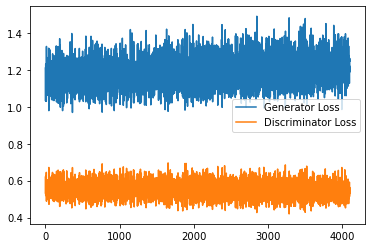

Saving fake_images-1090.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 175, step 82500: Generator loss: 1.2149256529808043, discriminator loss: 0.5398370431065559


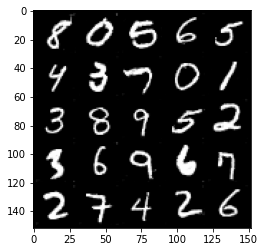

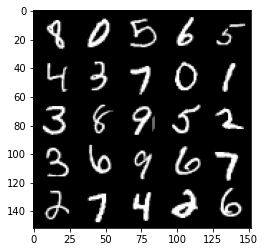

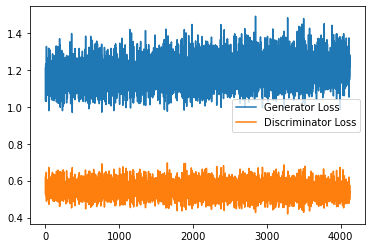

Saving fake_images-1091.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 176, step 83000: Generator loss: 1.2165568212270736, discriminator loss: 0.5435546631217003


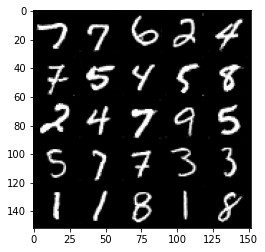

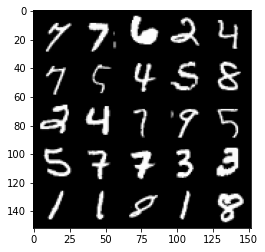

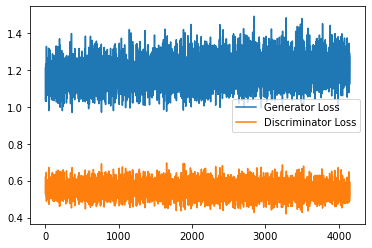

Saving fake_images-1092.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1093.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 178, step 83500: Generator loss: 1.2125075764656066, discriminator loss: 0.5449941464066506


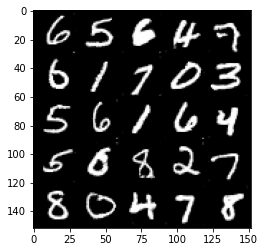

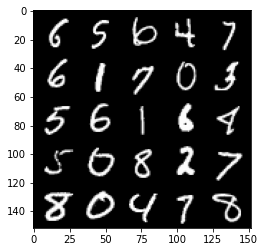

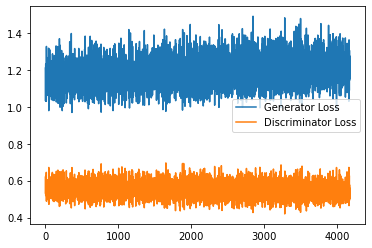

Saving fake_images-1094.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 179, step 84000: Generator loss: 1.2247667231559753, discriminator loss: 0.5439129289984703


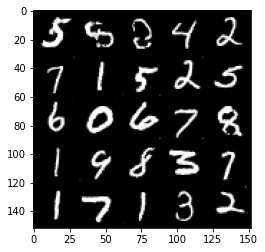

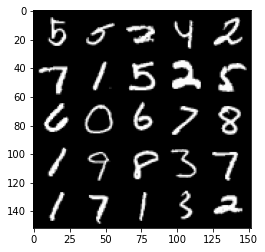

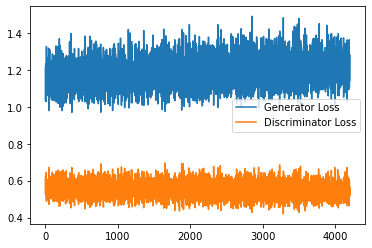

Saving fake_images-1095.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 180, step 84500: Generator loss: 1.2241238263845444, discriminator loss: 0.5395933066010475


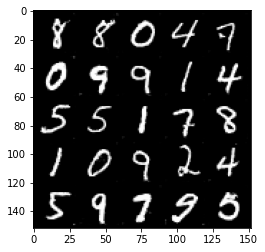

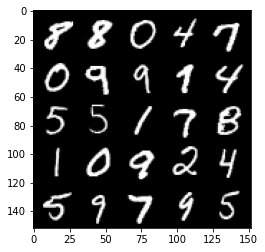

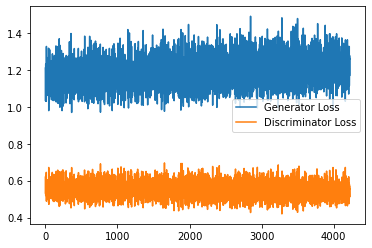

Saving fake_images-1096.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 181, step 85000: Generator loss: 1.2333206994533539, discriminator loss: 0.5415176525712013


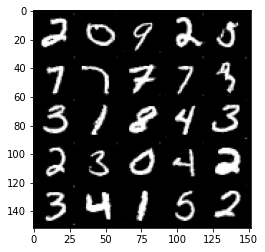

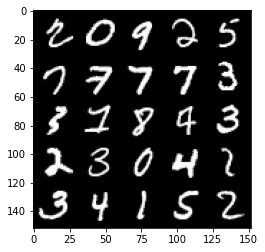

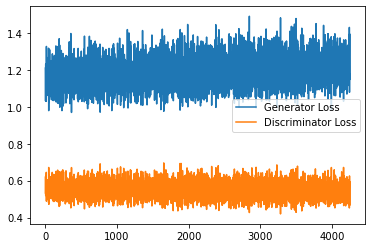

Saving fake_images-1097.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 182, step 85500: Generator loss: 1.224438493013382, discriminator loss: 0.5413767222762108


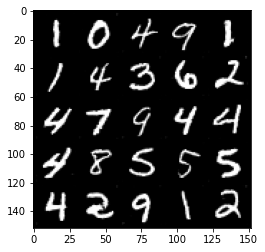

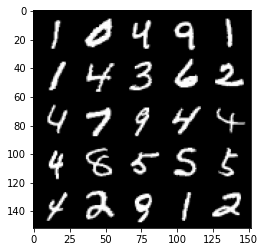

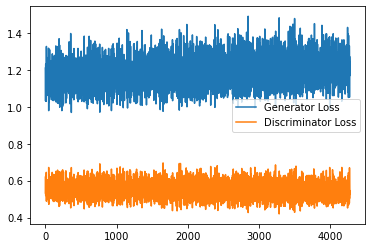

Saving fake_images-1098.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 183, step 86000: Generator loss: 1.2294630402326583, discriminator loss: 0.5429647487998008


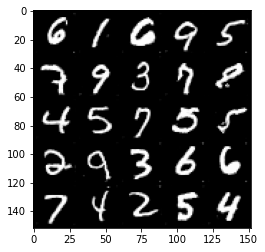

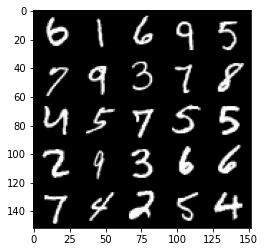

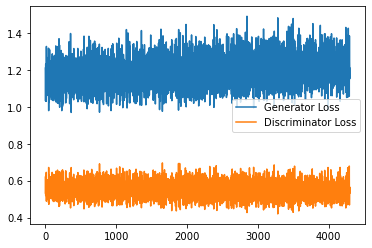

Saving fake_images-1099.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 184, step 86500: Generator loss: 1.245803759098053, discriminator loss: 0.5361747869253158


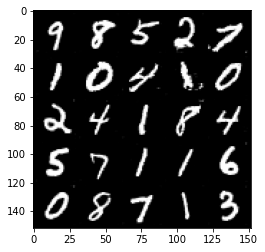

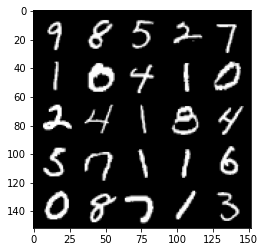

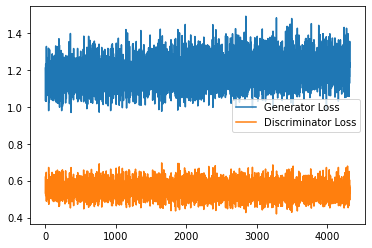

Saving fake_images-1100.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 185, step 87000: Generator loss: 1.2205902156829833, discriminator loss: 0.5385727383494378


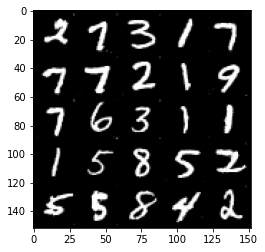

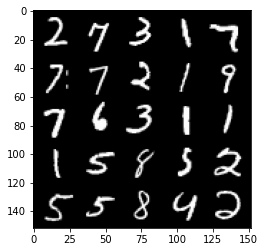

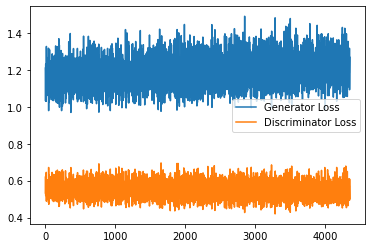

Saving fake_images-1101.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 186, step 87500: Generator loss: 1.2318961304426193, discriminator loss: 0.544916011929512


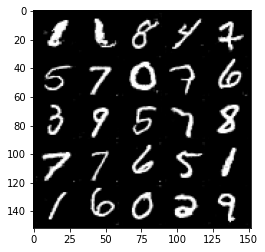

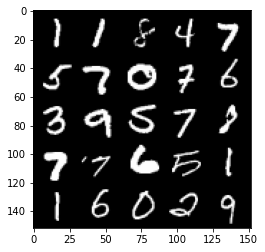

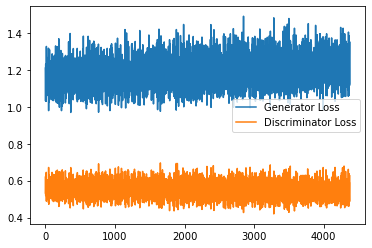

Saving fake_images-1102.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 187, step 88000: Generator loss: 1.2306879703998566, discriminator loss: 0.5399477376937866


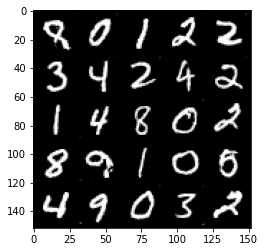

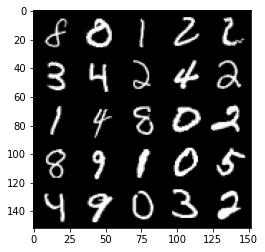

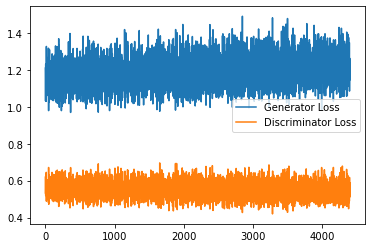

Saving fake_images-1103.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 188, step 88500: Generator loss: 1.2192581235170363, discriminator loss: 0.5417428779006004


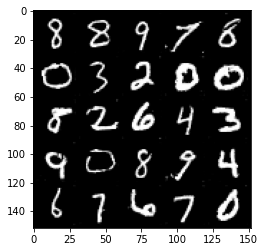

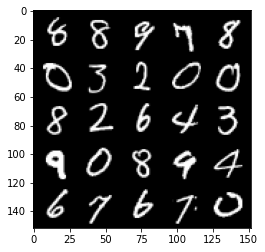

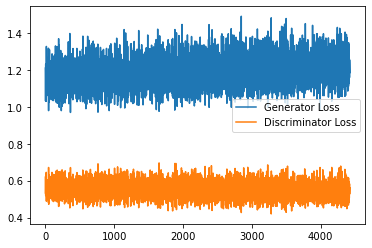

Saving fake_images-1104.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 189, step 89000: Generator loss: 1.2402394709587097, discriminator loss: 0.5436469130516052


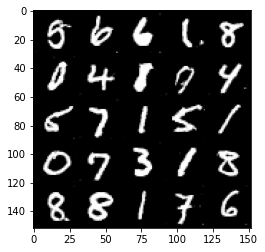

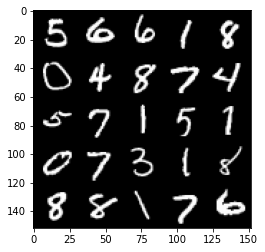

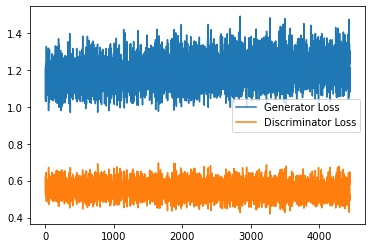

Saving fake_images-1105.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 190, step 89500: Generator loss: 1.2348183903694152, discriminator loss: 0.5389096125364303


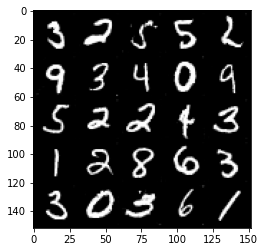

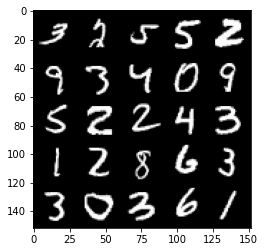

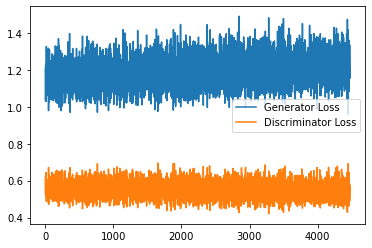

Saving fake_images-1106.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 191, step 90000: Generator loss: 1.2312595821619035, discriminator loss: 0.542212308704853


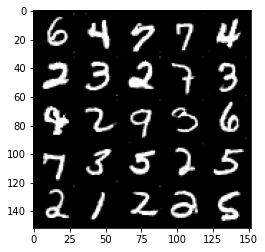

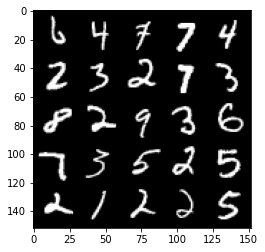

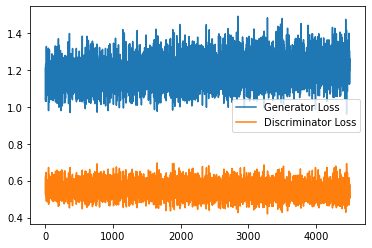

Saving fake_images-1107.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 192, step 90500: Generator loss: 1.2253518224954605, discriminator loss: 0.5441830588579177


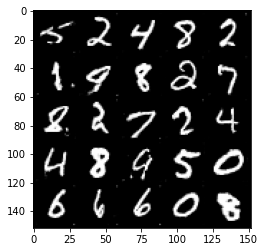

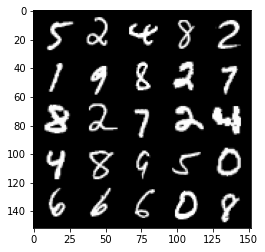

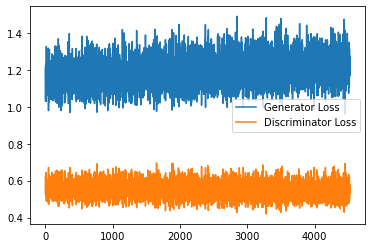

Saving fake_images-1108.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1109.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 194, step 91000: Generator loss: 1.2155887415409088, discriminator loss: 0.5409992913603783


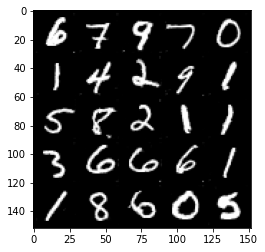

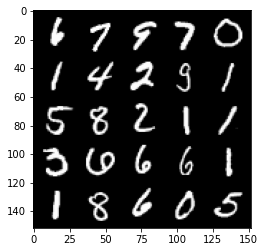

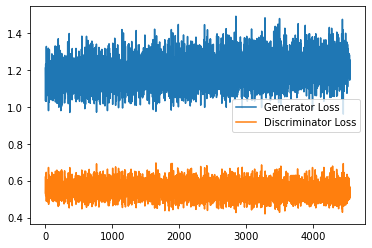

Saving fake_images-1110.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 195, step 91500: Generator loss: 1.2173594448566436, discriminator loss: 0.5401580051779747


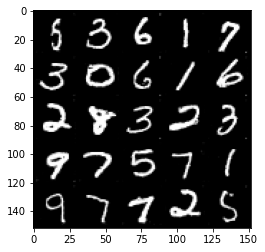

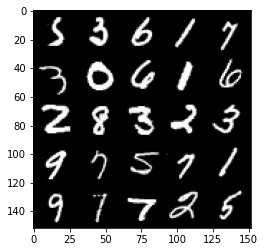

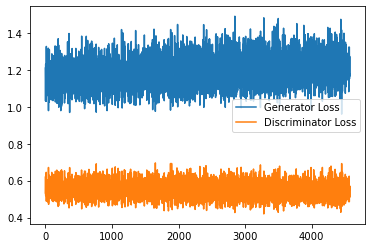

Saving fake_images-1111.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 196, step 92000: Generator loss: 1.2425093389749526, discriminator loss: 0.5410620433688164


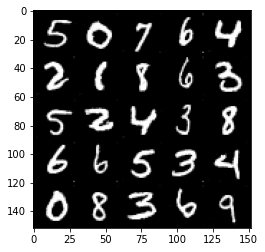

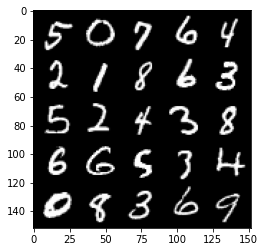

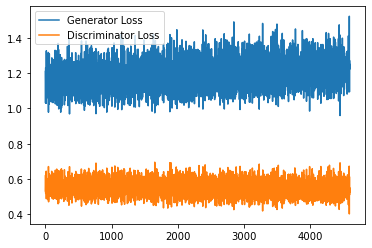

Saving fake_images-1112.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 197, step 92500: Generator loss: 1.2325966575145721, discriminator loss: 0.5371495494246483


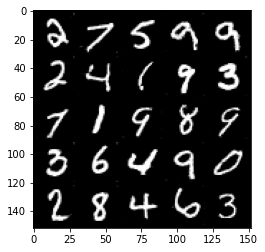

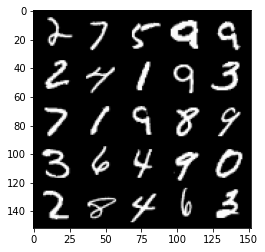

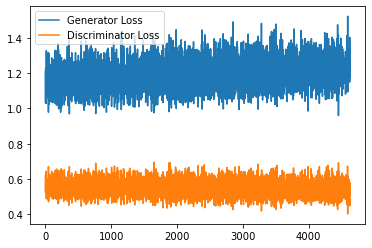

Saving fake_images-1113.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 198, step 93000: Generator loss: 1.232650180220604, discriminator loss: 0.5402538617253303


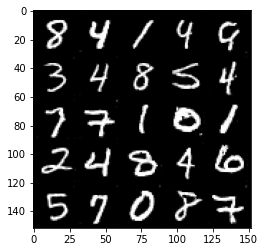

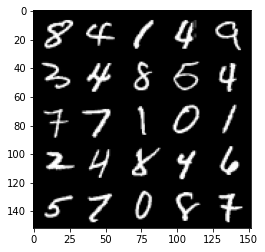

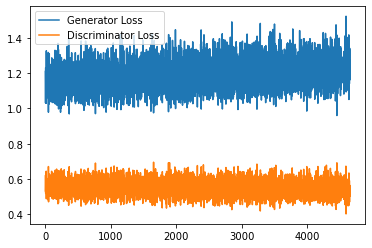

Saving fake_images-1114.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 199, step 93500: Generator loss: 1.2365390692949294, discriminator loss: 0.5364899131059646


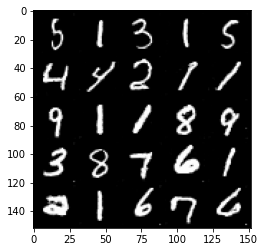

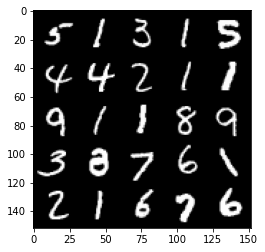

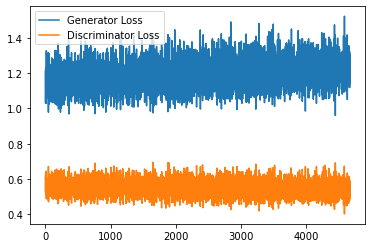

Saving fake_images-1115.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 200, step 94000: Generator loss: 1.222764259815216, discriminator loss: 0.5403371493220329


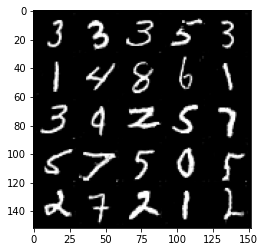

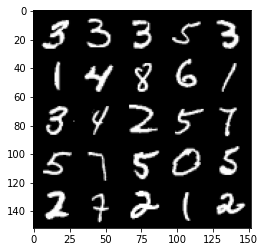

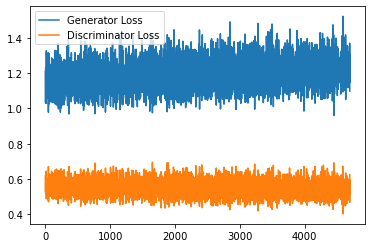

Saving fake_images-1116.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 201, step 94500: Generator loss: 1.2318959259986877, discriminator loss: 0.5407238696217537


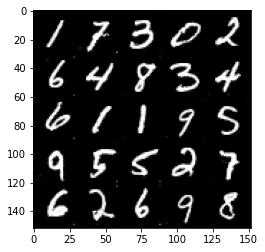

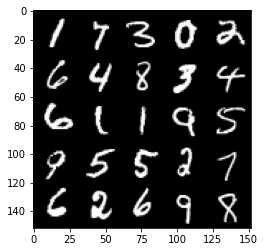

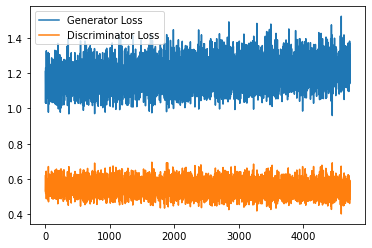

Saving fake_images-1117.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 202, step 95000: Generator loss: 1.2263021171092987, discriminator loss: 0.5386771093606949


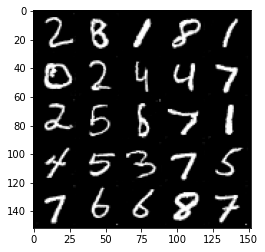

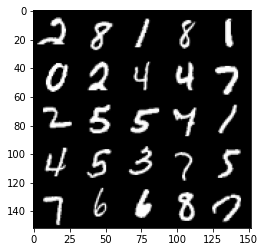

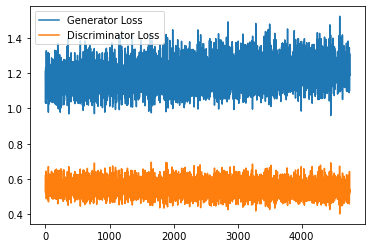

Saving fake_images-1118.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 203, step 95500: Generator loss: 1.225750986814499, discriminator loss: 0.5420830855369568


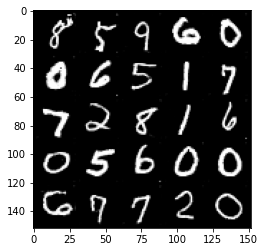

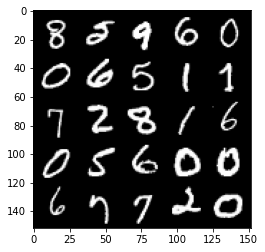

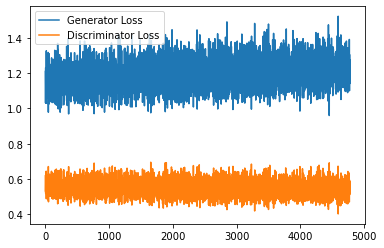

Saving fake_images-1119.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 204, step 96000: Generator loss: 1.232075297832489, discriminator loss: 0.5387608576416969


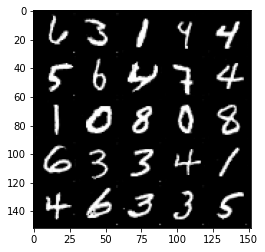

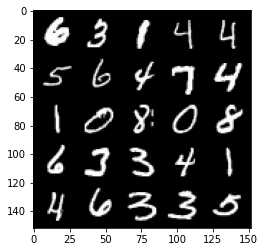

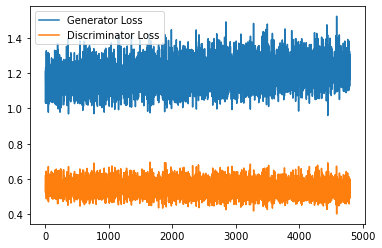

Saving fake_images-1120.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 205, step 96500: Generator loss: 1.2328941904306412, discriminator loss: 0.5416071618199348


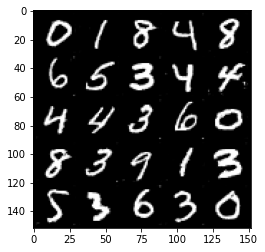

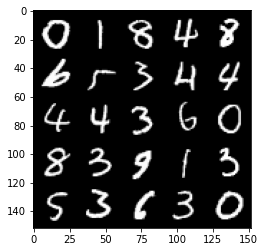

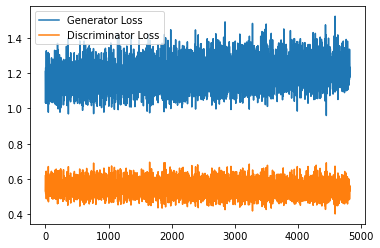

Saving fake_images-1121.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 206, step 97000: Generator loss: 1.2367736155986786, discriminator loss: 0.5386628729104995


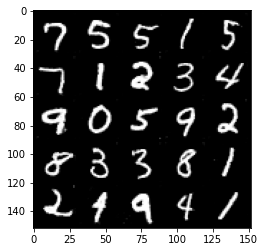

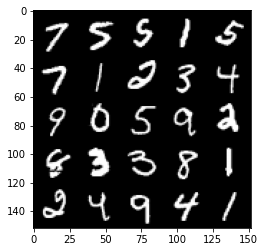

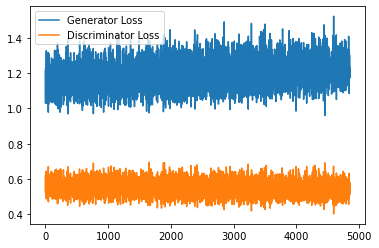

Saving fake_images-1122.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 207, step 97500: Generator loss: 1.2375669528245925, discriminator loss: 0.5411341945528985


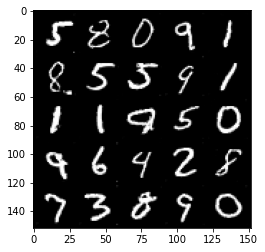

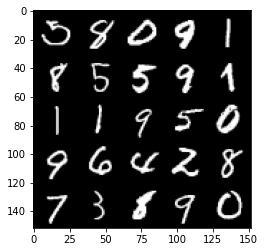

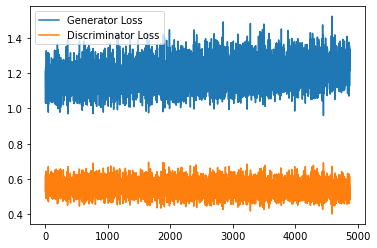

Saving fake_images-1123.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 208, step 98000: Generator loss: 1.234486387014389, discriminator loss: 0.5389188573360443


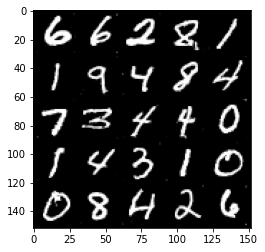

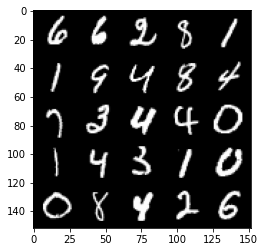

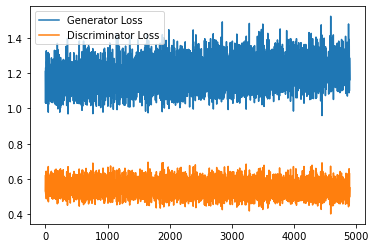

Saving fake_images-1124.png


  0%|          | 0/469 [00:00<?, ?it/s]

Saving fake_images-1125.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 210, step 98500: Generator loss: 1.233208773136139, discriminator loss: 0.538121711730957


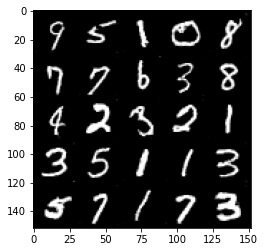

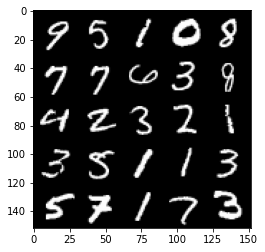

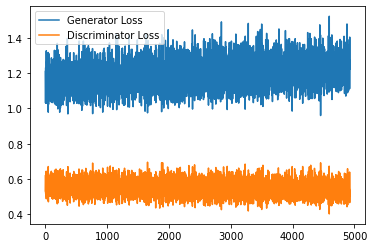

Saving fake_images-1126.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 211, step 99000: Generator loss: 1.2388842461109162, discriminator loss: 0.5422620319724083


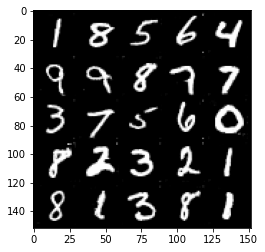

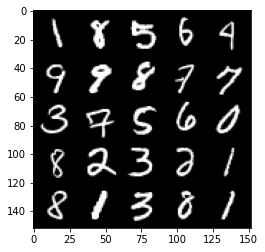

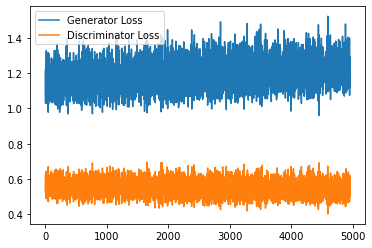

Saving fake_images-1127.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 212, step 99500: Generator loss: 1.2400544278621675, discriminator loss: 0.5411067321300507


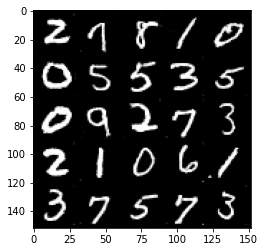

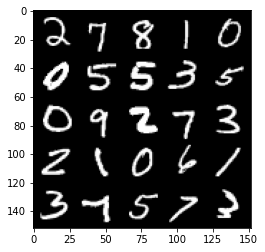

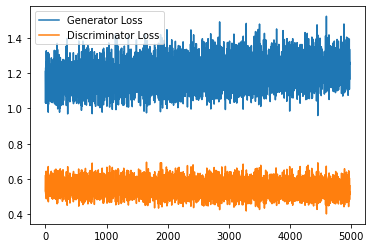

Saving fake_images-1128.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 213, step 100000: Generator loss: 1.2282213447093964, discriminator loss: 0.5399133397340774


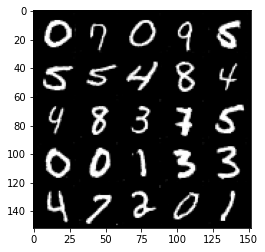

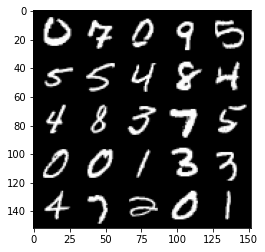

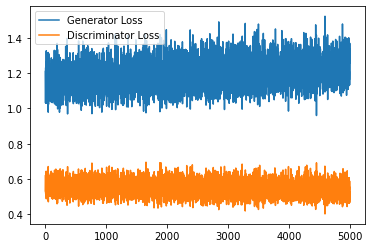

Saving fake_images-1129.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 214, step 100500: Generator loss: 1.2322024437189103, discriminator loss: 0.538951103746891


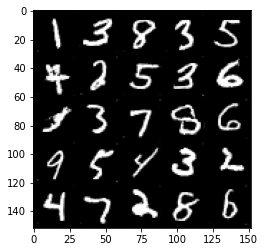

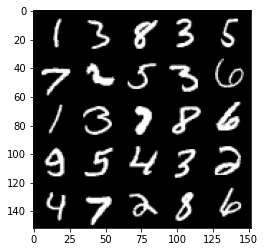

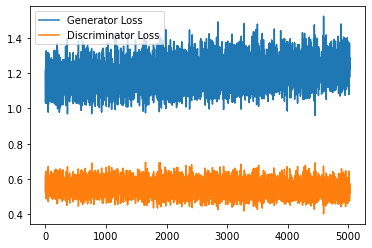

Saving fake_images-1130.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 215, step 101000: Generator loss: 1.236598254442215, discriminator loss: 0.5445769109725952


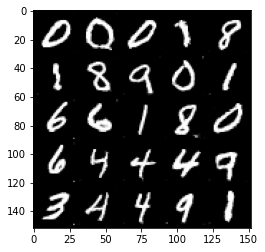

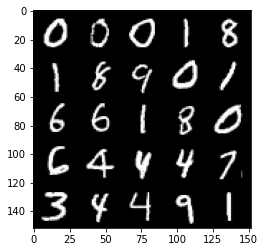

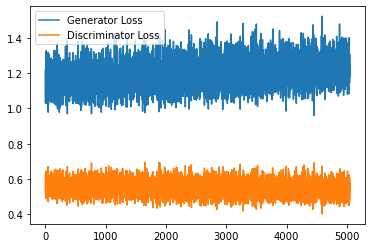

Saving fake_images-1131.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 216, step 101500: Generator loss: 1.2409295264482498, discriminator loss: 0.5384356858134269


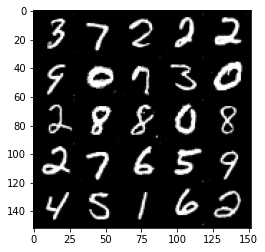

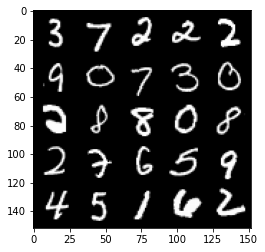

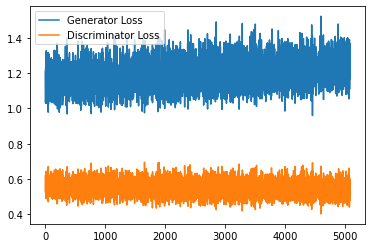

Saving fake_images-1132.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 217, step 102000: Generator loss: 1.2277560822963716, discriminator loss: 0.5386675493717193


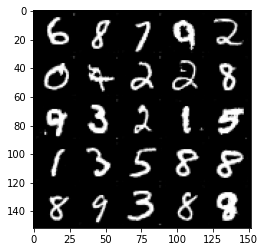

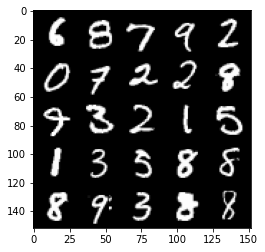

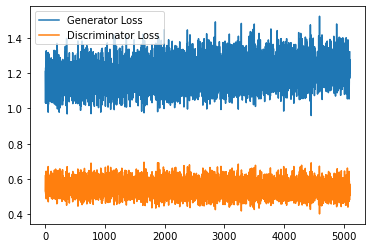

Saving fake_images-1133.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 218, step 102500: Generator loss: 1.2229703998565673, discriminator loss: 0.5394206002950669


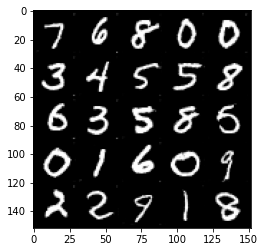

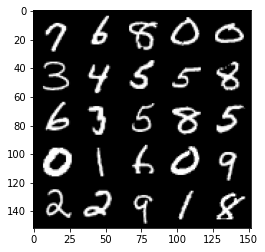

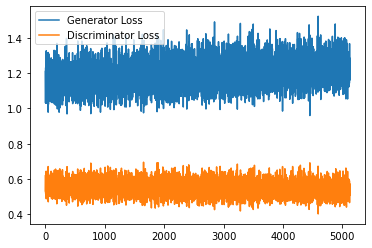

Saving fake_images-1134.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 219, step 103000: Generator loss: 1.226138594508171, discriminator loss: 0.5439676409959793


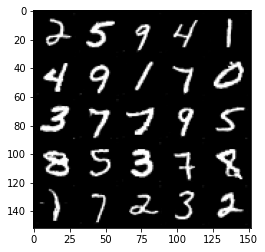

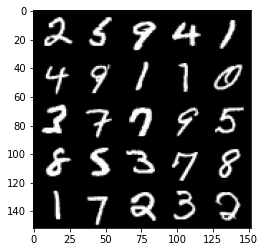

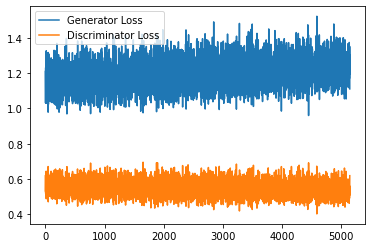

Saving fake_images-1135.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 220, step 103500: Generator loss: 1.2562511916160584, discriminator loss: 0.5355676130056382


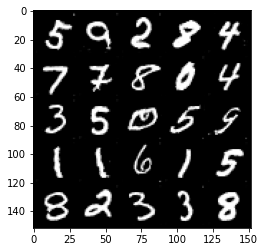

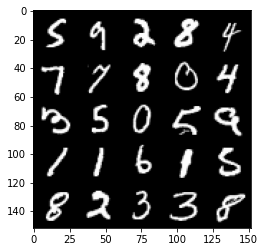

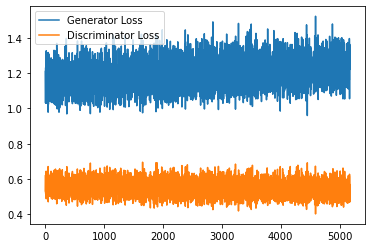

Saving fake_images-1136.png


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 221, step 104000: Generator loss: 1.2367542078495026, discriminator loss: 0.5387166654467582


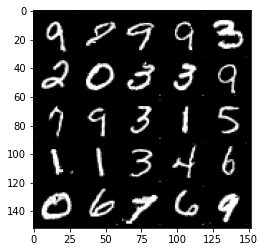

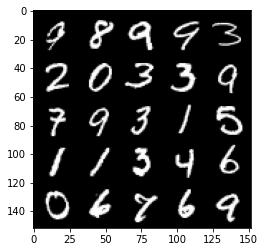

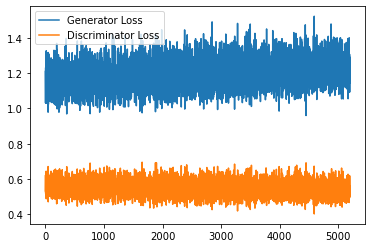

In [ ]:
if epoch_flag == True:
    previous_epochs = previous_epochs
elif epoch_flag == False:
    previous_epochs = 0

cur_step = 0
generator_losses = []
discriminator_losses = []


noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        #labels.fill_(6)
        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1
    all_epochs = epoch + 1 + previous_epochs
    if epoch_flag == True:
        save_fake_images(all_epochs,fake)
    elif epoch_flag == False:
        save_fake_images(epoch + 1,fake)

In [ ]:
# Saving the model and optimizer
torch.save({
            'epoch': all_epochs,
            'Gmodel_state_dict': gen.state_dict(),
            'Dmodel_state_dict': disc.state_dict(),
            'G_optimizer':gen_opt.state_dict(),
            'D_optimizer':disc_opt.state_dict()
              
            }, 'CGAN-MNIST.pt') 

In [ ]:
print("Number of Epochs after TrainingLoop:",all_epochs)

In [29]:
# Loading the model and optimizer
checkpoint = torch.load('CGAN-MNIST.pt')
gen.load_state_dict(checkpoint['Gmodel_state_dict']) # Load Generator model
disc.load_state_dict(checkpoint['Dmodel_state_dict']) # load Discriminator model
gen_opt.load_state_dict(checkpoint['G_optimizer']) # Load Generator's optimizer
disc_opt.load_state_dict(checkpoint['D_optimizer']) # Load Discriminator's optimizer
previous_epochs = checkpoint['epoch']
epoch_flag = True
print("Number of Epochs after training:",previous_epochs)

Number of Epochs after training: 915


In [ ]:
def create(inp):
    feature_map = { "zero":0,
                 "1":1,
                 "2":2,
                 "3":3,
                 "4":4,
                 "5":5,
                 "6":6,
                 "7":7,
                 "8":8,
                 "9": 9
                }
    samples = 128
    labels.fill_(feature_map[inp])
    one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
    
    fake_noise = get_noise(samples, z_dim, device=device)
    noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    show_tensor_images(fake)  
    
    

In [ ]:
create("zero")

In [ ]:
create("1")

In [ ]:
create("2")

In [ ]:
create("3")

In [ ]:
create("4")

In [ ]:
create("5")

In [ ]:
create("6")

In [ ]:
create("7")

In [ ]:
create("8")

In [ ]:
create("9")